# Woche 8: Data Visualization - Übung am eigenen Projekt

**Ziel dieser Übung:** Nachdem Sie die wichtigsten Visualisierungstechniken kennengelernt haben, wenden Sie dieses Wissen Schritt für Schritt auf Ihren eigenen bereinigten Datensatz an.

**Arbeitsweise:**
- Arbeiten Sie die Aufgaben nacheinander durch
- Nutzen Sie die Code-Zellen für Ihre Implementierung
- Orientieren Sie sich an den Beispielen aus dem Airbnb-Notebook
- Erstellen Sie aussagekräftige Visualisierungen für Ihre Forschungsfrage
- Speichern Sie wichtige Visualisierungen als Bilddateien

---
## 1. Bibliotheken importieren und Daten einlesen

**Aufgabe:** Importieren Sie die notwendigen Bibliotheken und laden Sie Ihren bereinigten Datensatz aus Woche 7.

**Hinweise:**
- Importieren Sie: `pandas`, `numpy`, `matplotlib.pyplot`, `seaborn`, `plotly.express`, `plotly.graph_objects`
- Konfigurieren Sie die Visualisierungsstile
- Laden Sie Ihren bereinigten CSV-Datensatz

In [2]:
# Bibliotheken importieren
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

# Visualisierungsstile konfigurieren
sns.set_style('whitegrid')
plt.rcParams['figure.figsize'] = (10, 6)

# Bereinigten Datensatz einlesen
df = pd.read_csv('../data/processed/exam_score_prediction_cleaned.csv')


---
## 2. Ersten Überblick verschaffen

**Aufgabe:** Verschaffen Sie sich einen Überblick über Ihren bereinigten Datensatz.

**Was Sie prüfen sollten:**
- Dimensionen des Datensatzes
- Datentypen der Spalten
- Statistische Kennzahlen
- Erste Zeilen anzeigen

In [3]:
# Dimensionen
print("rows:", df.shape[0])
print("colums:", df.shape[1])

rows: 20000
colums: 13


In [4]:
# Erste Zeilen
df.head()

,Unnamed: 0,age,gender,course,study_hours,class_attendance,internet_access,sleep_hours,sleep_quality,study_method,facility_rating,exam_difficulty,exam_score
0,0,17,male,Diploma,2.78,92.9,True,7.4,poor,coaching,low,hard,58.9
1,1,23,other,B.Sc.,3.37,64.8,True,4.6,average,online videos,medium,moderate,54.8
2,2,22,male,B.Sc.,7.88,76.8,True,8.5,poor,coaching,high,moderate,90.3
3,3,20,other,Diploma,0.67,48.4,True,5.8,average,online videos,low,moderate,29.7
4,4,20,female,Diploma,0.89,71.6,True,9.8,poor,coaching,low,moderate,43.7


In [5]:
# Informationen zu Spalten
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20000 entries, 0 to 19999
Data columns (total 13 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Unnamed: 0        20000 non-null  int64  
 1   age               20000 non-null  int64  
 2   gender            20000 non-null  object 
 3   course            20000 non-null  object 
 4   study_hours       20000 non-null  float64
 5   class_attendance  20000 non-null  float64
 6   internet_access   20000 non-null  bool   
 7   sleep_hours       20000 non-null  float64
 8   sleep_quality     20000 non-null  object 
 9   study_method      20000 non-null  object 
 10  facility_rating   20000 non-null  object 
 11  exam_difficulty   20000 non-null  object 
 12  exam_score        20000 non-null  float64
dtypes: bool(1), float64(4), int64(2), object(6)
memory usage: 1.9+ MB


<Axes: xlabel='age', ylabel='Count'>

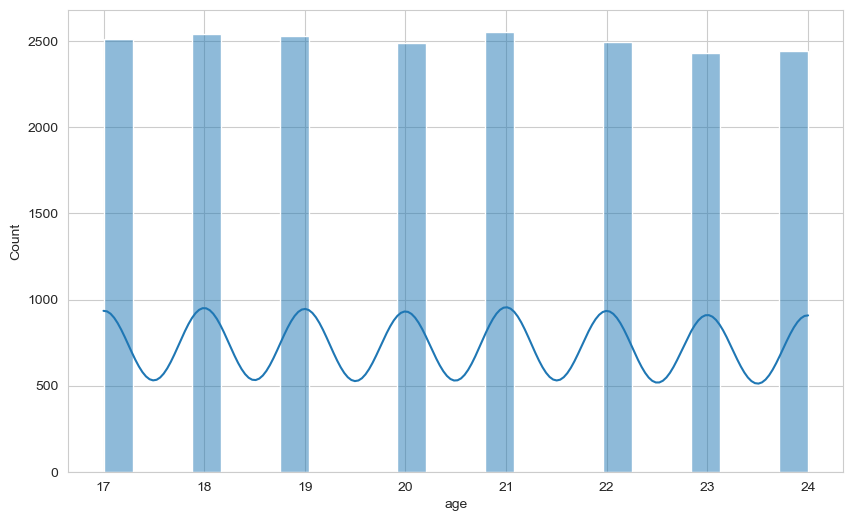

In [6]:
# Statistische Übersicht
# Histogram with KDE
sns.histplot(data=df, x='age', kde=True)

<Axes: xlabel='gender', ylabel='exam_score'>

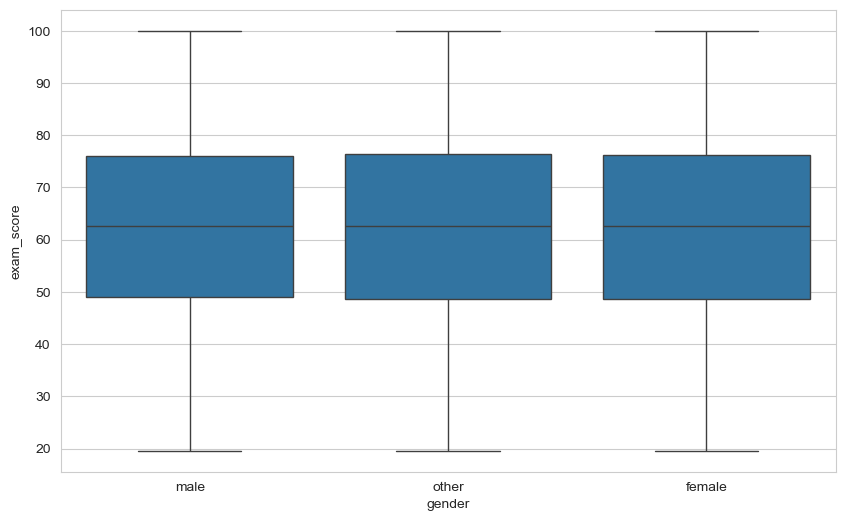

In [7]:
# Boxplot by category
sns.boxplot(data=df, x='gender', y='exam_score')

---
## 3. Univariate Analysen - Verteilungen einzelner Variablen

**Aufgabe:** Visualisieren Sie die Verteilung einzelner Variablen.

**Für numerische Variablen:**
- Histogramme
- Boxplots
- Violin Plots
- Density Plots

**Für kategoriale Variablen:**
- Bar Charts
- Count Plots
- Pie Charts (bei wenigen Kategorien)

In [8]:
# Numerische Spalten identifizieren
numeric_cols = df.select_dtypes(include=['int64', 'float64']).columns
numeric_cols = numeric_cols[1:]
print(f"Numerische Spalten: {list(numeric_cols)}")


Numerische Spalten: ['age', 'study_hours', 'class_attendance', 'sleep_hours', 'exam_score']


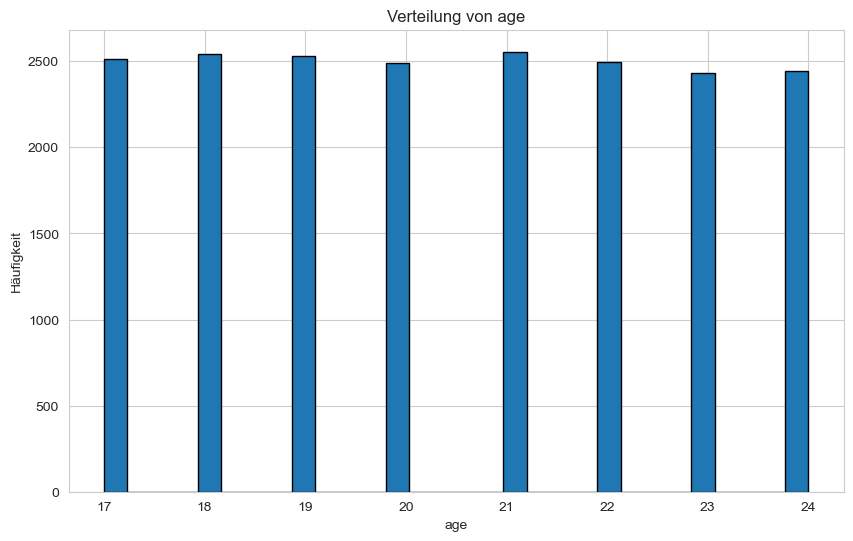

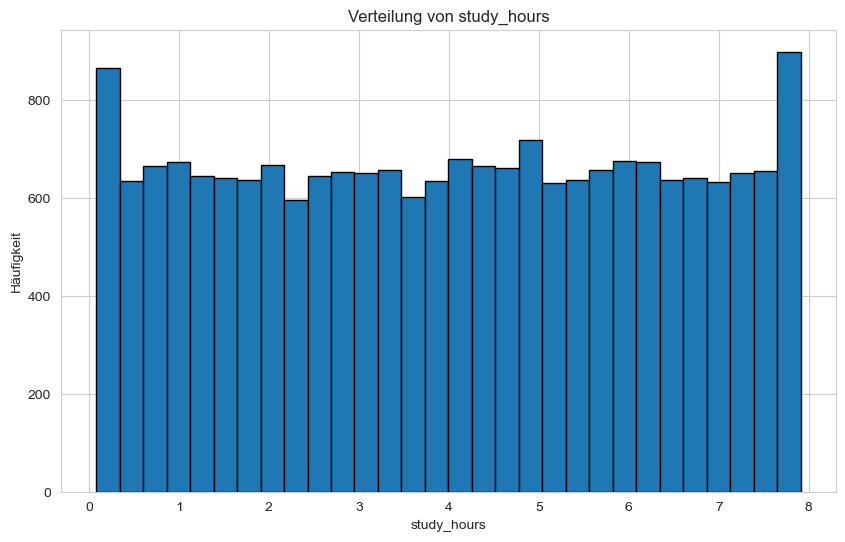

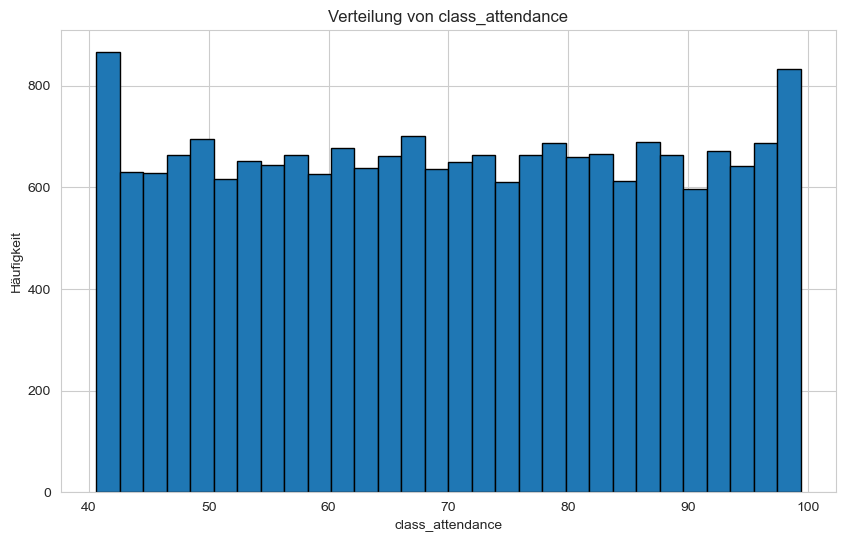

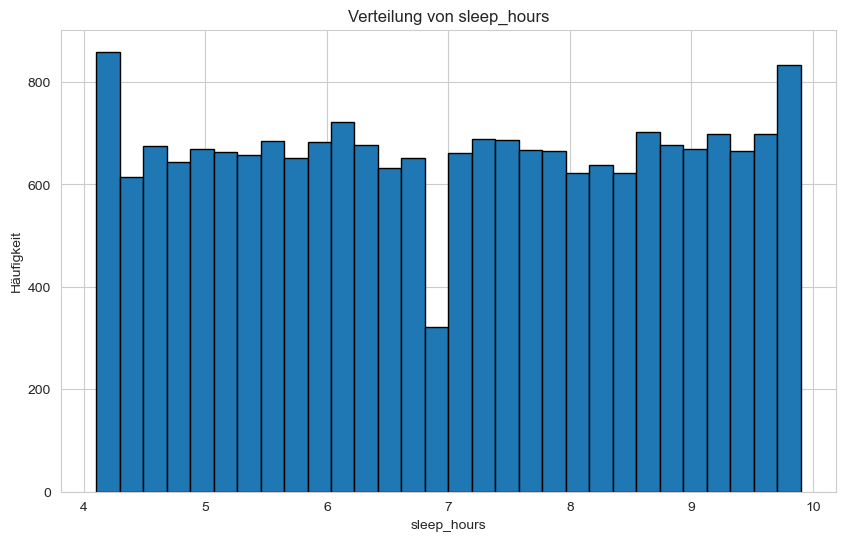

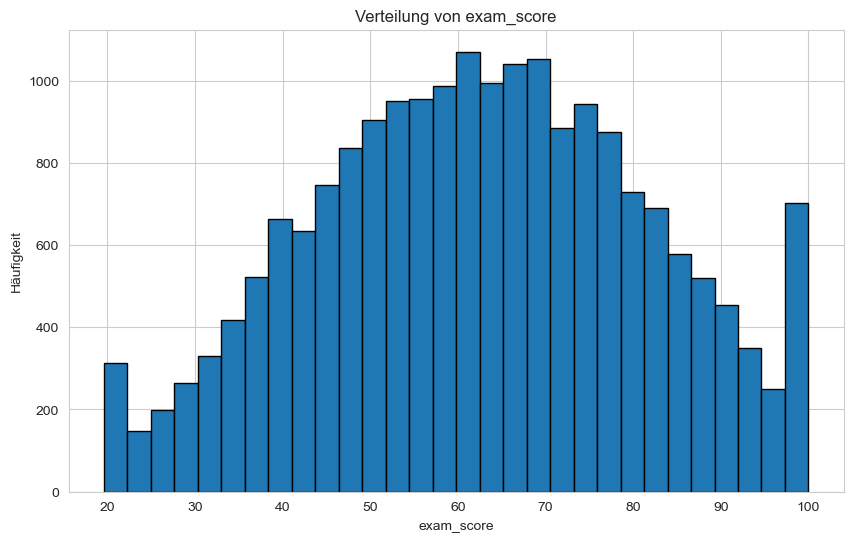

In [9]:
# Histogramm für eine numerische Variable
for num_col in numeric_cols:
    plt.figure(figsize=(10, 6))
    plt.hist(df[num_col], bins=30, edgecolor='black')
    plt.title(f'Verteilung von {num_col}')
    plt.xlabel(num_col)
    plt.ylabel('Häufigkeit')
    plt.show()


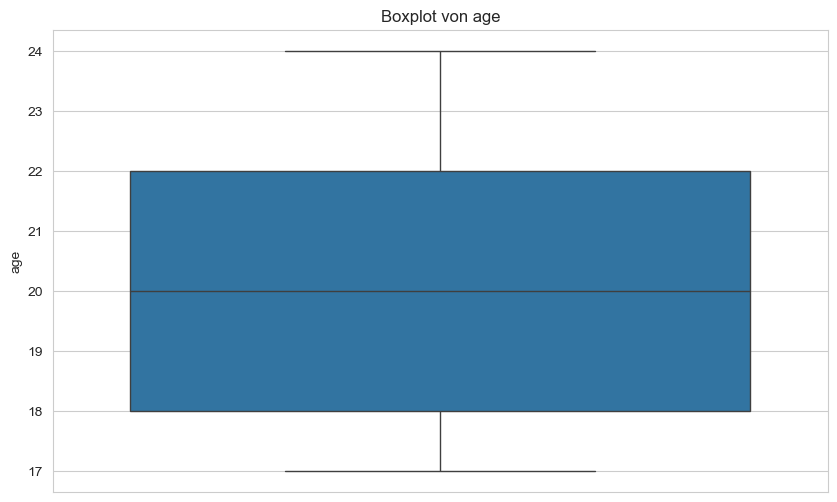

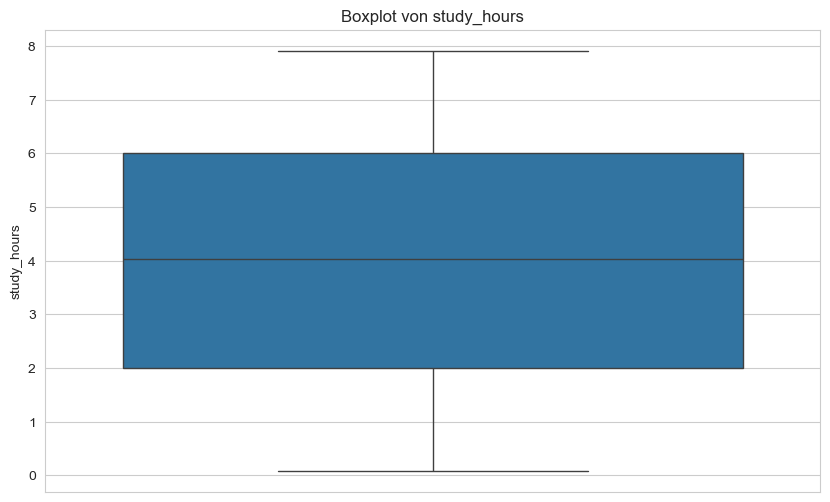

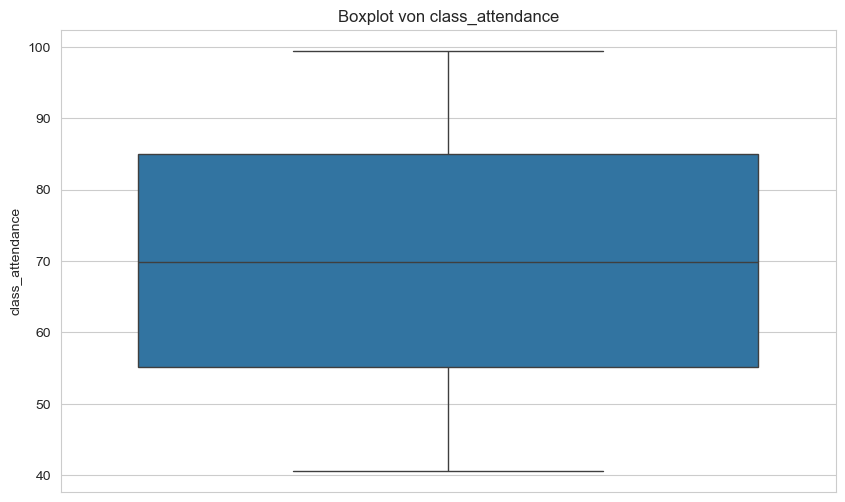

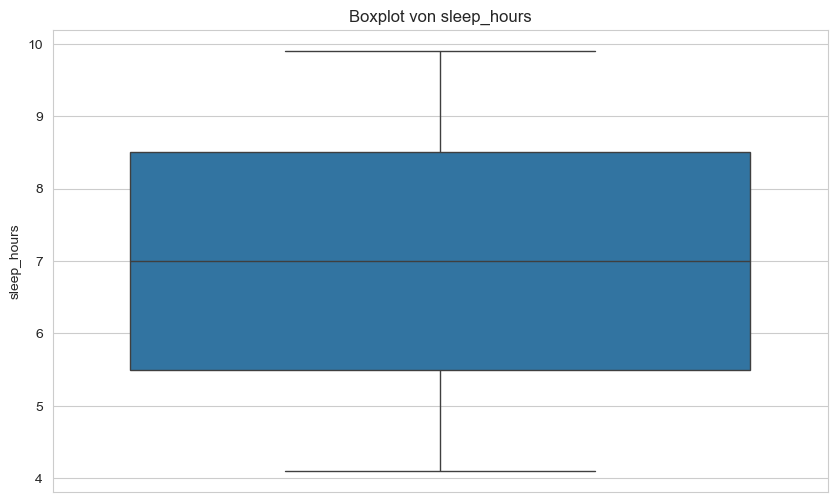

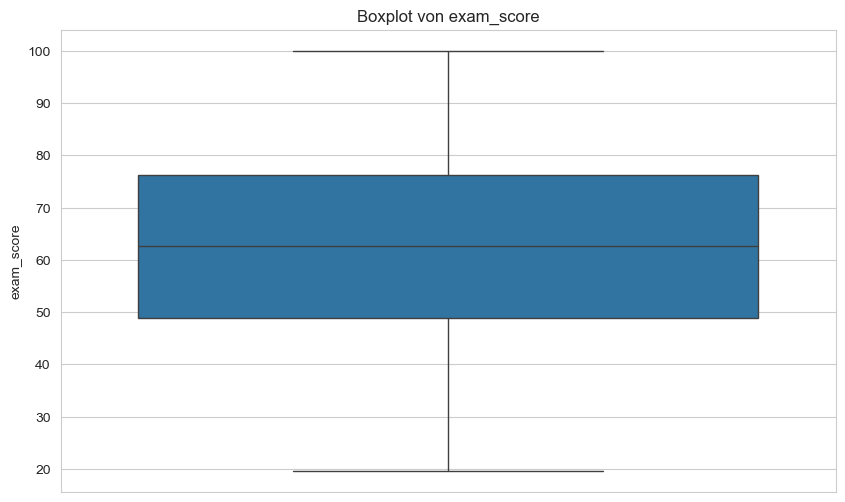

In [10]:
# Boxplot für eine numerische Variable
for num_col in numeric_cols:
    plt.figure(figsize=(10, 6))
    sns.boxplot(y=df[num_col])
    plt.title(f'Boxplot von {num_col}')
    plt.show()


In [11]:
# Kategoriale Spalten identifizieren
categorical_cols = df.select_dtypes(include=['object', 'category']).columns
print(f"Kategoriale Spalten: {list(categorical_cols)}")


Kategoriale Spalten: ['gender', 'course', 'sleep_quality', 'study_method', 'facility_rating', 'exam_difficulty']


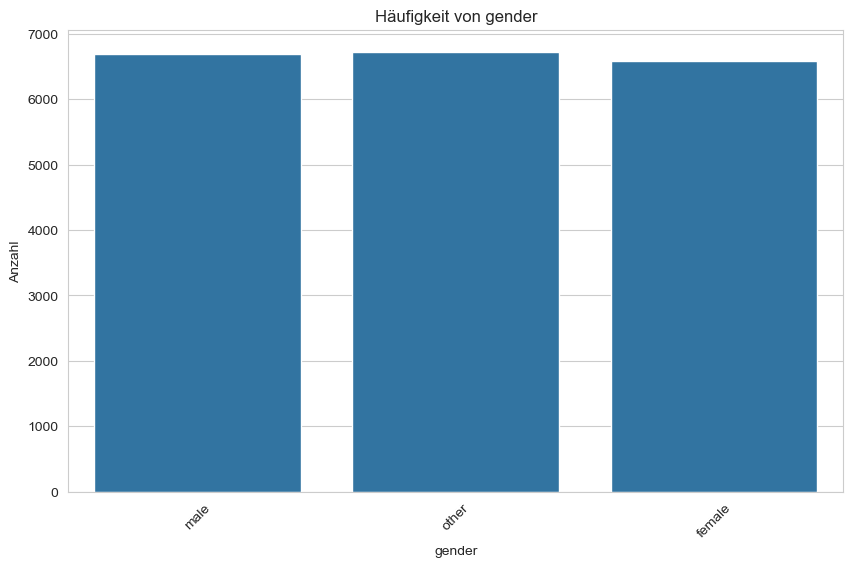

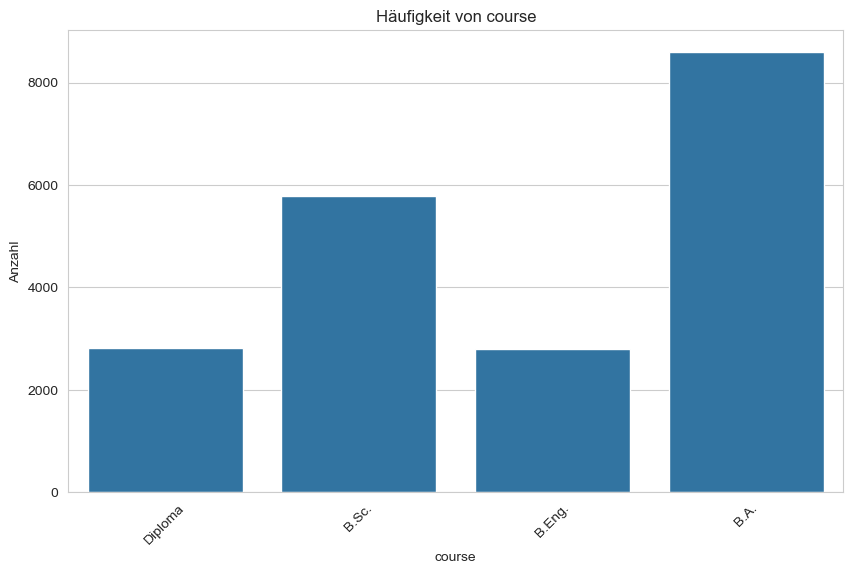

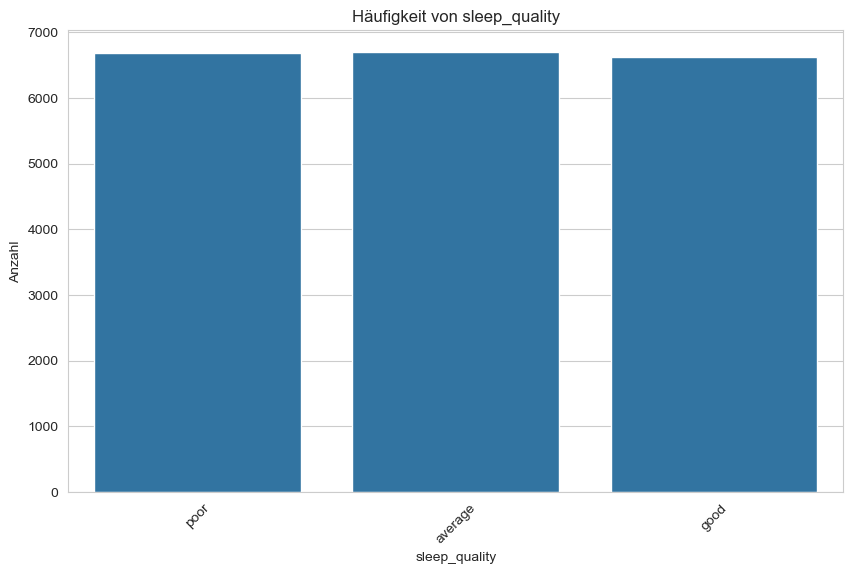

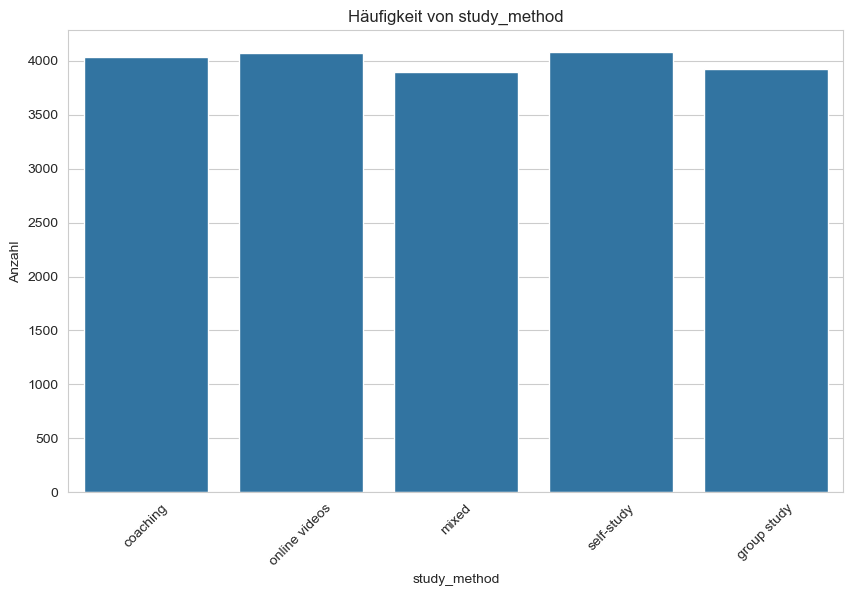

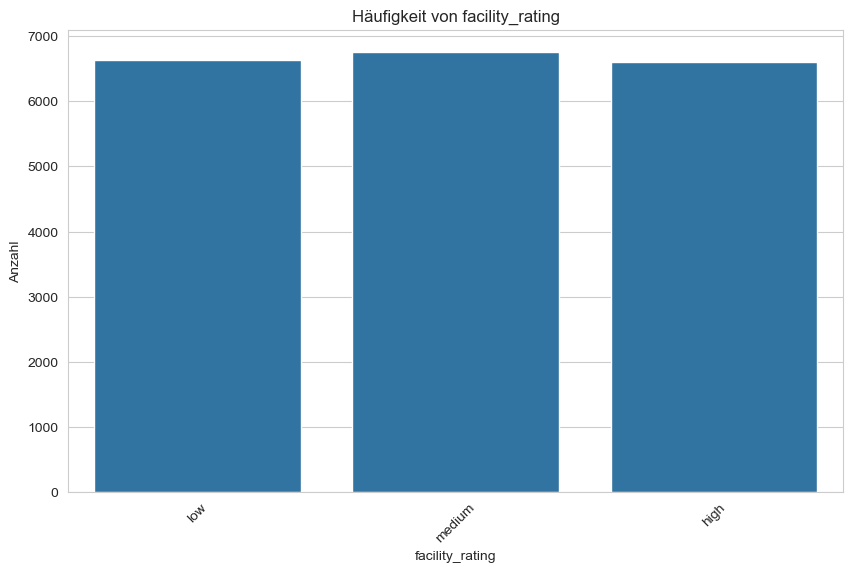

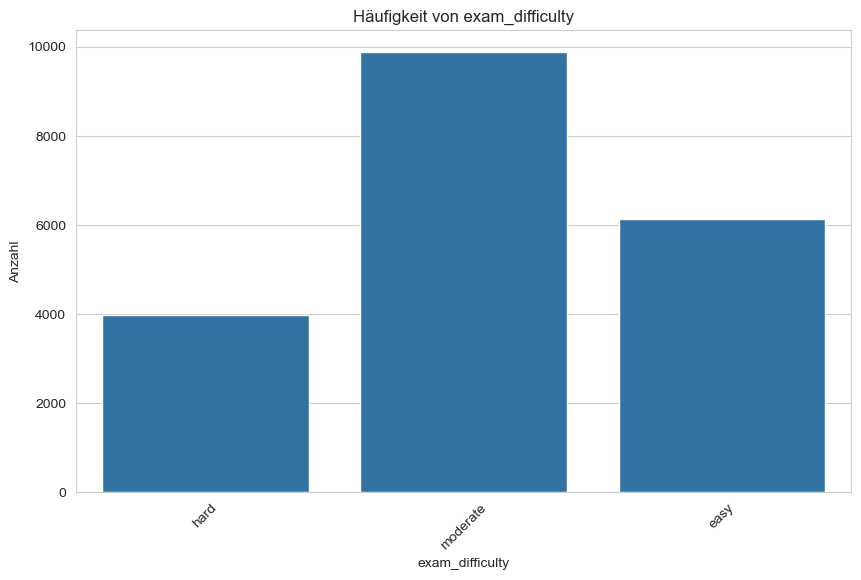

In [12]:
# Count Plot für eine kategoriale Variable
for cat_col in categorical_cols:
    plt.figure(figsize=(10, 6))
    sns.countplot(data=df, x=cat_col)
    plt.title(f'Häufigkeit von {cat_col}')
    plt.xlabel(cat_col)
    plt.ylabel('Anzahl')
    plt.xticks(rotation=45)
    plt.show()


---
## 4. Bivariate Analysen - Beziehungen zwischen zwei Variablen

**Aufgabe:** Untersuchen Sie Beziehungen zwischen zwei Variablen.

**Mögliche Visualisierungen:**
- Scatter Plots (numerisch vs. numerisch)
- Line Plots (bei Zeitreihen)
- Grouped Bar Charts (kategorial vs. numerisch)
- Box Plots nach Kategorien (kategorial vs. numerisch)
- Violin Plots nach Kategorien

**Research Question:**
"Can we predict exam scores based on a student’s academic behavior, study habits, lifestyle routines, and exam conditions?"

**Welche Beziehungen könnten interessant sein?**
- study_hours vs. exam_score
  - Scatter Plots
- class_attendance vs. exam_score
  - Scatter Plots
- internet_access vs. exam_score
  - Grouped Bar Charts oder Box Plots nach Kategorien
- sleep_hours vs. exam_score
  - Scatter Plots
- sleep_quality vs. exam_score
  - Grouped Bar Charts oder Box Plots nach Kategorien
- study_method vs. exam_score
  - Grouped Bar Charts oder Box Plots nach Kategorien
- exam_difficulty vs. exam_score
  - Grouped Bar Charts oder Box Plots nach Kategorien

In [13]:
# Beispiel: Scatter Plot (numerisch vs. numerisch)
# plt.figure(figsize=(10, 6))
# plt.scatter(df['spalte1'], df['spalte2'], alpha=0.5)
# plt.title('Beziehung zwischen [Spalte1] und [Spalte2]')
# plt.xlabel('[Spalte1]')
# plt.ylabel('[Spalte2]')
# plt.show()


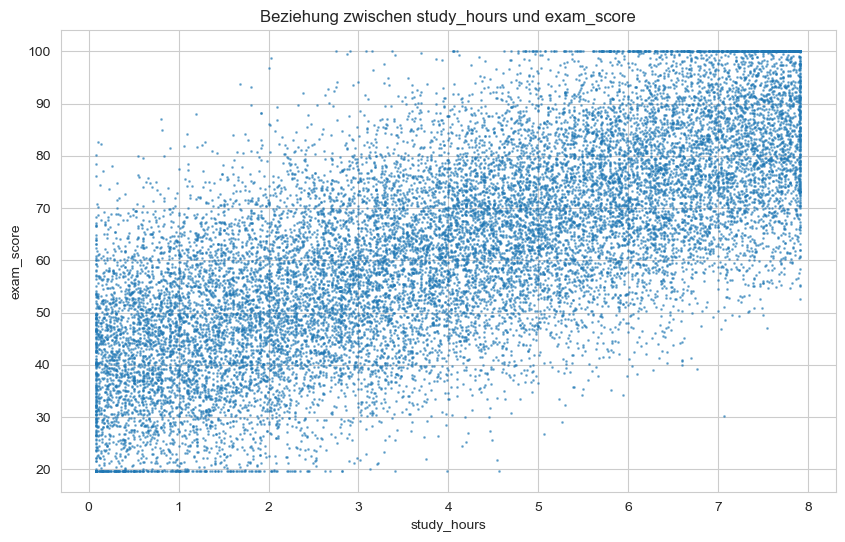

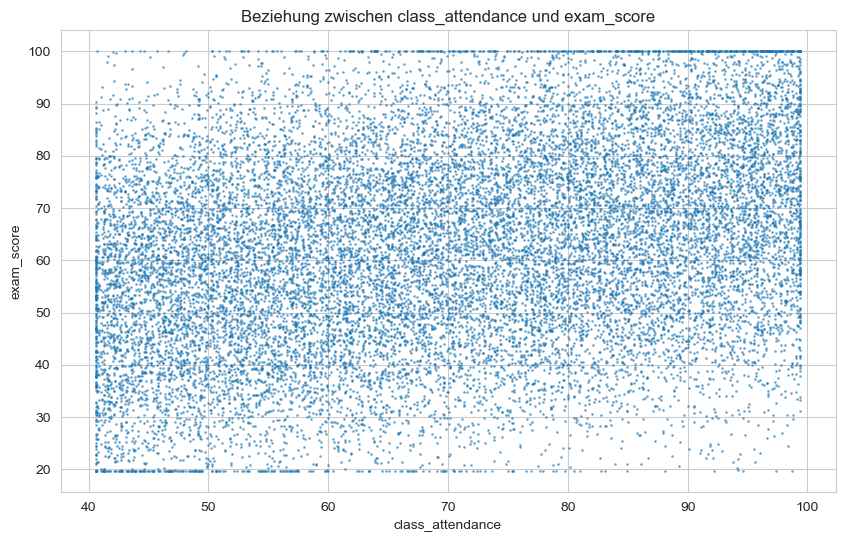

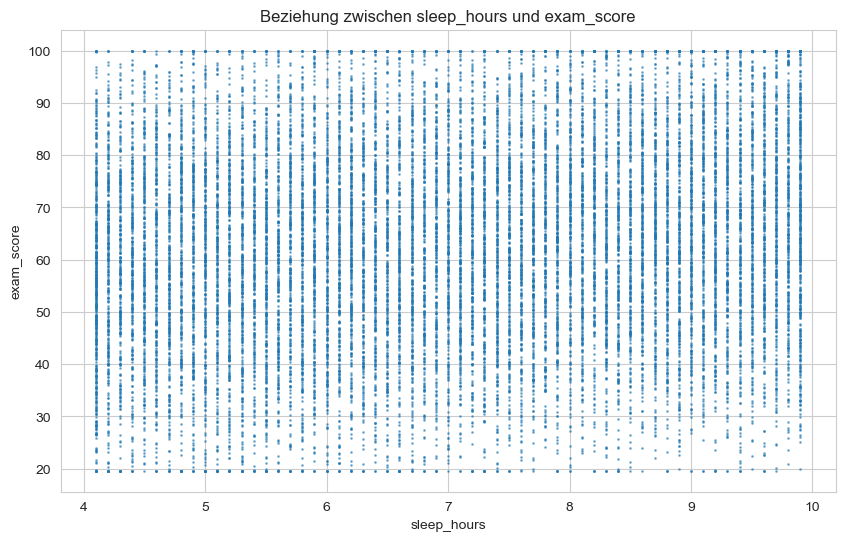

In [14]:
# Scatter Plot (num_col vs. exam_score)
# numeric_cols besteht aus ['age', 'study_hours', 'class_attendance', 'sleep_hours', 'exam_score']
for num_col in numeric_cols[1:4]:
    plt.figure(figsize=(10, 6))
    plt.scatter(df[num_col], df['exam_score'], alpha=0.5, s=1)
    plt.title(f'Beziehung zwischen {num_col} und exam_score')
    plt.xlabel(num_col)
    plt.ylabel('exam_score')
    plt.show()


In [15]:
# Beispiel: Grouped Bar Chart
# grouped_data = df.groupby('kategoriale_spalte')['numerische_spalte'].mean()
# plt.figure(figsize=(10, 6))
# grouped_data.plot(kind='bar')
# plt.title('Durchschnittliche [Numerische Spalte] nach [Kategoriale Spalte]')
# plt.xlabel('[Kategoriale Spalte]')
# plt.ylabel('Durchschnitt [Numerische Spalte]')
# plt.xticks(rotation=45)
# plt.show()


In [16]:
# Beispiel: Boxplot nach Kategorien
# plt.figure(figsize=(12, 6))
# sns.boxplot(data=df, x='kategoriale_spalte', y='numerische_spalte')
# plt.title('[Numerische Spalte] nach [Kategoriale Spalte]')
# plt.xticks(rotation=45)
# plt.show()


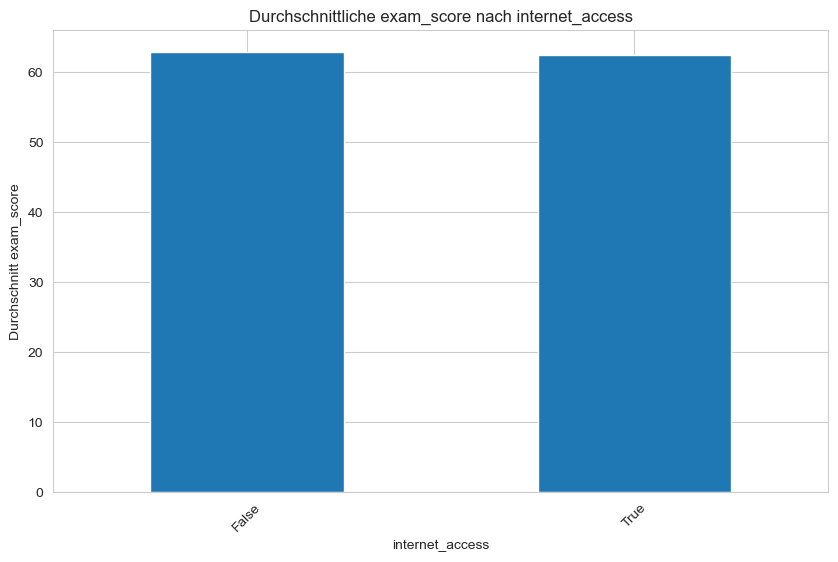

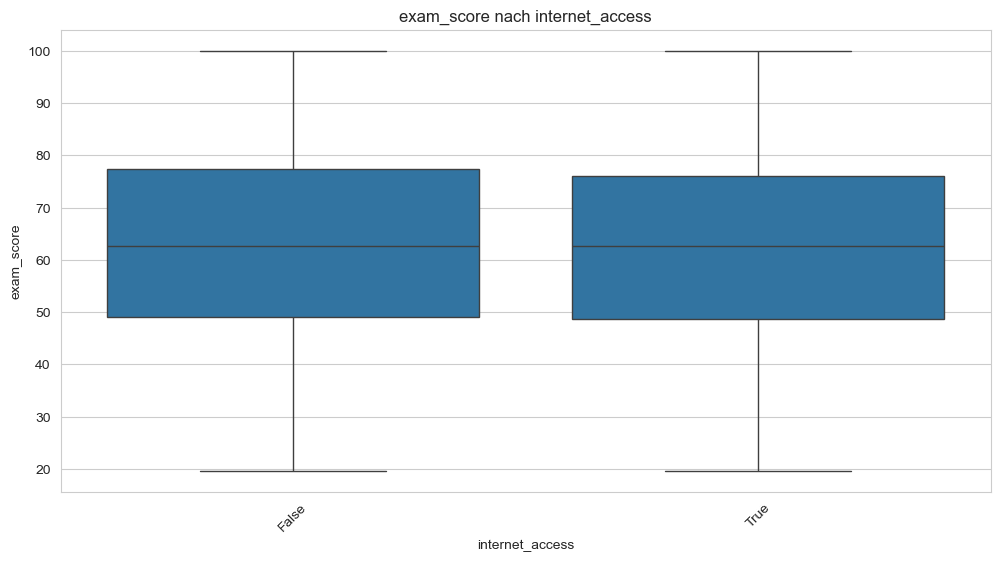

In [17]:
# Grouped Bar Chart (internet_access vs. exam_score)
grouped_data = df.groupby('internet_access')['exam_score'].mean()
plt.figure(figsize=(10, 6))
grouped_data.plot(kind='bar')
plt.title('Durchschnittliche exam_score nach internet_access')
plt.xlabel('internet_access')
plt.ylabel('Durchschnitt exam_score')
plt.xticks(rotation=45)
plt.show()

# Boxplot nach Kategorien (internet_access vs. exam_score)
plt.figure(figsize=(12, 6))
sns.boxplot(data=df, x='internet_access', y='exam_score')
plt.title('exam_score nach internet_access')
plt.xticks(rotation=45)
plt.show()


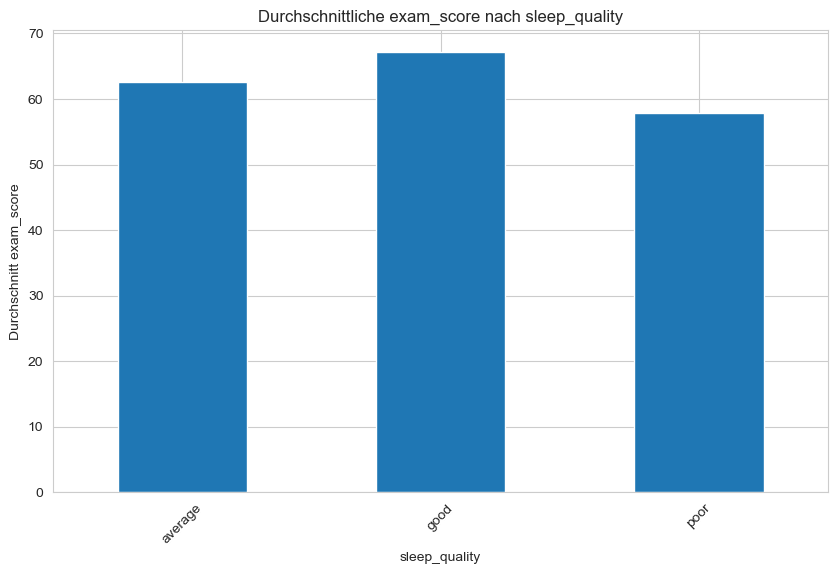

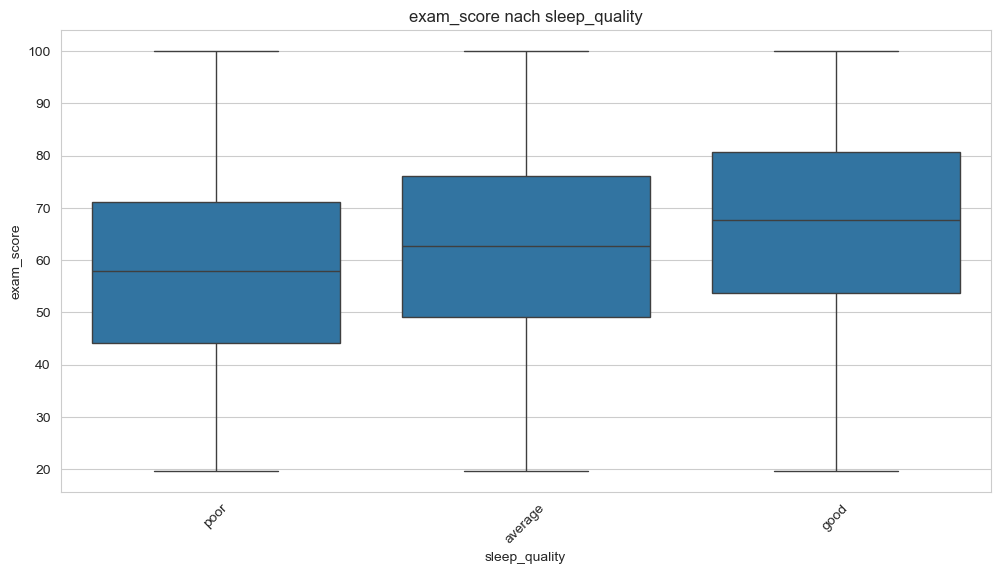

In [18]:
# Grouped Bar Chart (sleep_quality vs. exam_score)
grouped_data = df.groupby('sleep_quality')['exam_score'].mean()
plt.figure(figsize=(10, 6))
grouped_data.plot(kind='bar')
plt.title('Durchschnittliche exam_score nach sleep_quality')
plt.xlabel('sleep_quality')
plt.ylabel('Durchschnitt exam_score')
plt.xticks(rotation=45)
plt.show()

# Boxplot nach Kategorien (sleep_quality vs. exam_score)
plt.figure(figsize=(12, 6))
sns.boxplot(data=df, x='sleep_quality', y='exam_score')
plt.title('exam_score nach sleep_quality')
plt.xticks(rotation=45)
plt.show()


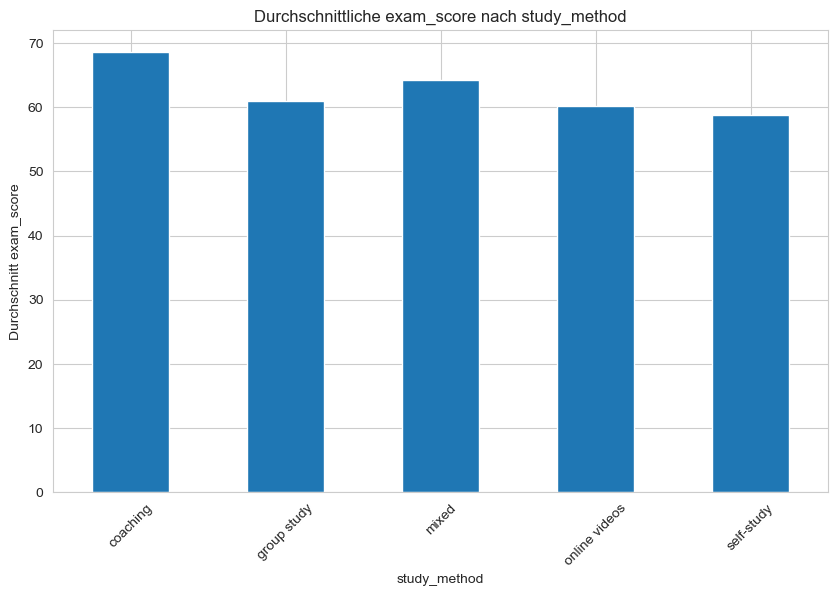

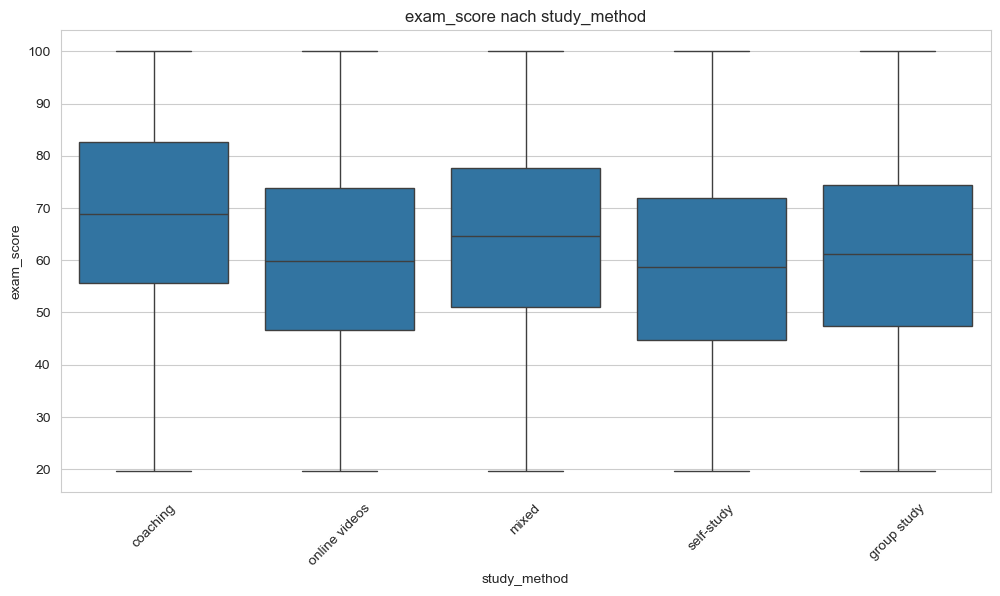

In [19]:
# Grouped Bar Chart (study_method vs. exam_score)
grouped_data = df.groupby('study_method')['exam_score'].mean()
plt.figure(figsize=(10, 6))
grouped_data.plot(kind='bar')
plt.title('Durchschnittliche exam_score nach study_method')
plt.xlabel('study_method')
plt.ylabel('Durchschnitt exam_score')
plt.xticks(rotation=45)
plt.show()

# Boxplot nach Kategorien (study_method vs. exam_score)
plt.figure(figsize=(12, 6))
sns.boxplot(data=df, x='study_method', y='exam_score')
plt.title('exam_score nach study_method')
plt.xticks(rotation=45)
plt.show()


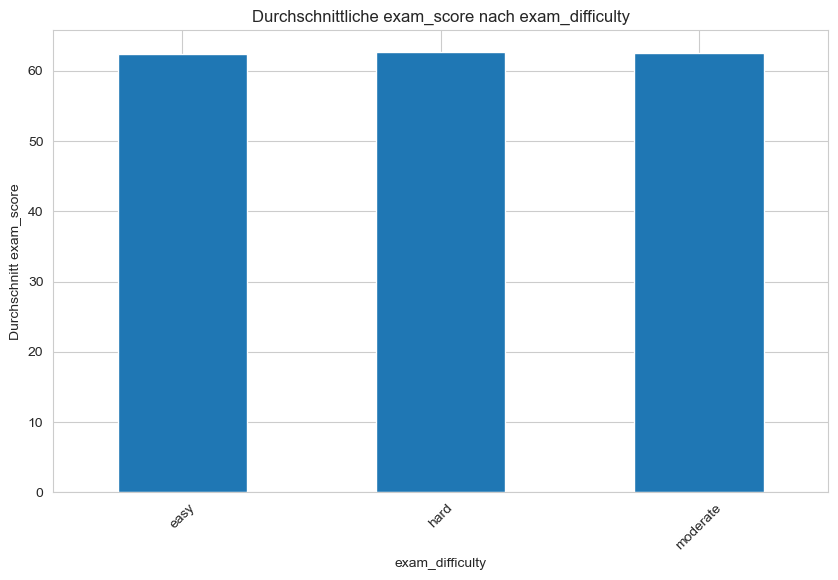

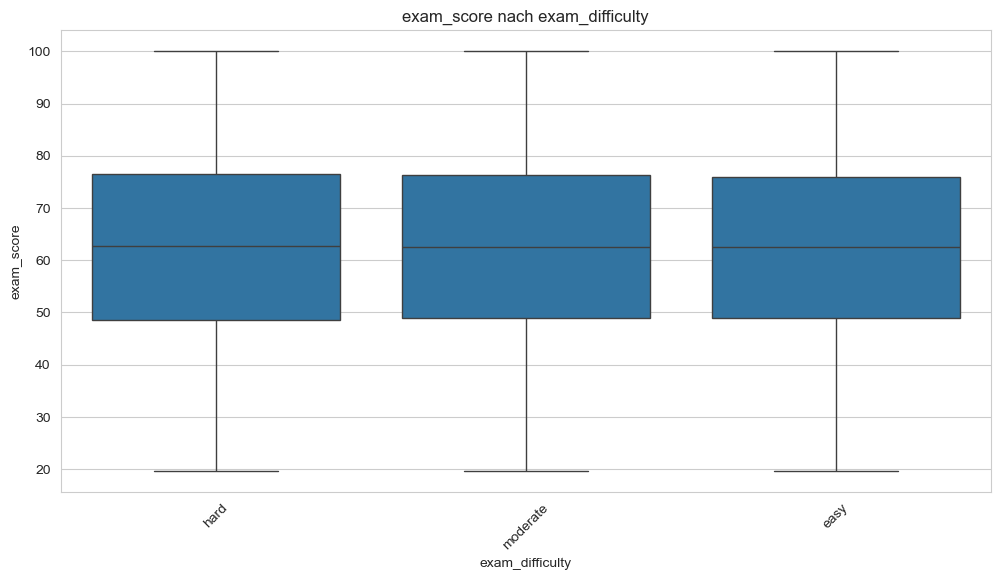

In [20]:
# Grouped Bar Chart (exam_difficulty vs. exam_score)
grouped_data = df.groupby('exam_difficulty')['exam_score'].mean()
plt.figure(figsize=(10, 6))
grouped_data.plot(kind='bar')
plt.title('Durchschnittliche exam_score nach exam_difficulty')
plt.xlabel('exam_difficulty')
plt.ylabel('Durchschnitt exam_score')
plt.xticks(rotation=45)
plt.show()

# Boxplot nach Kategorien (exam_difficulty vs. exam_score)
plt.figure(figsize=(12, 6))
sns.boxplot(data=df, x='exam_difficulty', y='exam_score')
plt.title('exam_score nach exam_difficulty')
plt.xticks(rotation=45)
plt.show()


---
## 5. Korrelationsanalyse

**Aufgabe:** Untersuchen Sie Korrelationen zwischen numerischen Variablen.

**Visualisierungen:**
- Korrelationsmatrix als Heatmap
- Pairplot für ausgewählte Variablen

**Hinweis:** Korrelationen zeigen nur lineare Beziehungen!

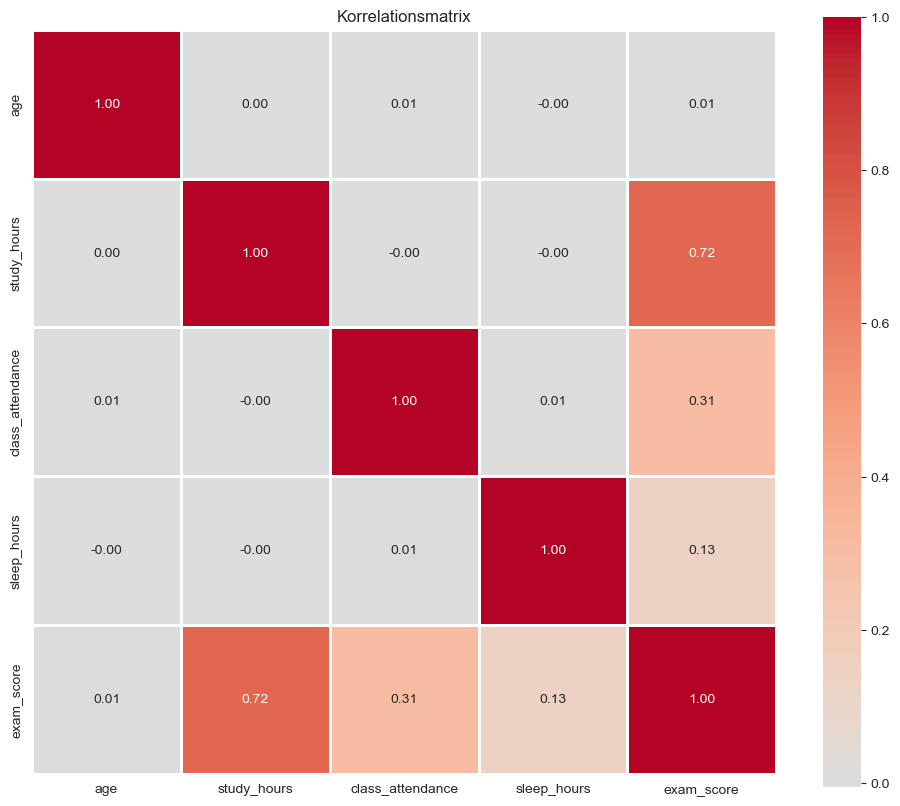

In [21]:
# Korrelationsmatrix berechnen
correlation_matrix = df[numeric_cols].corr()

# Heatmap der Korrelationen
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0, 
            square=True, linewidths=1, fmt='.2f')
plt.title('Korrelationsmatrix')
plt.show()


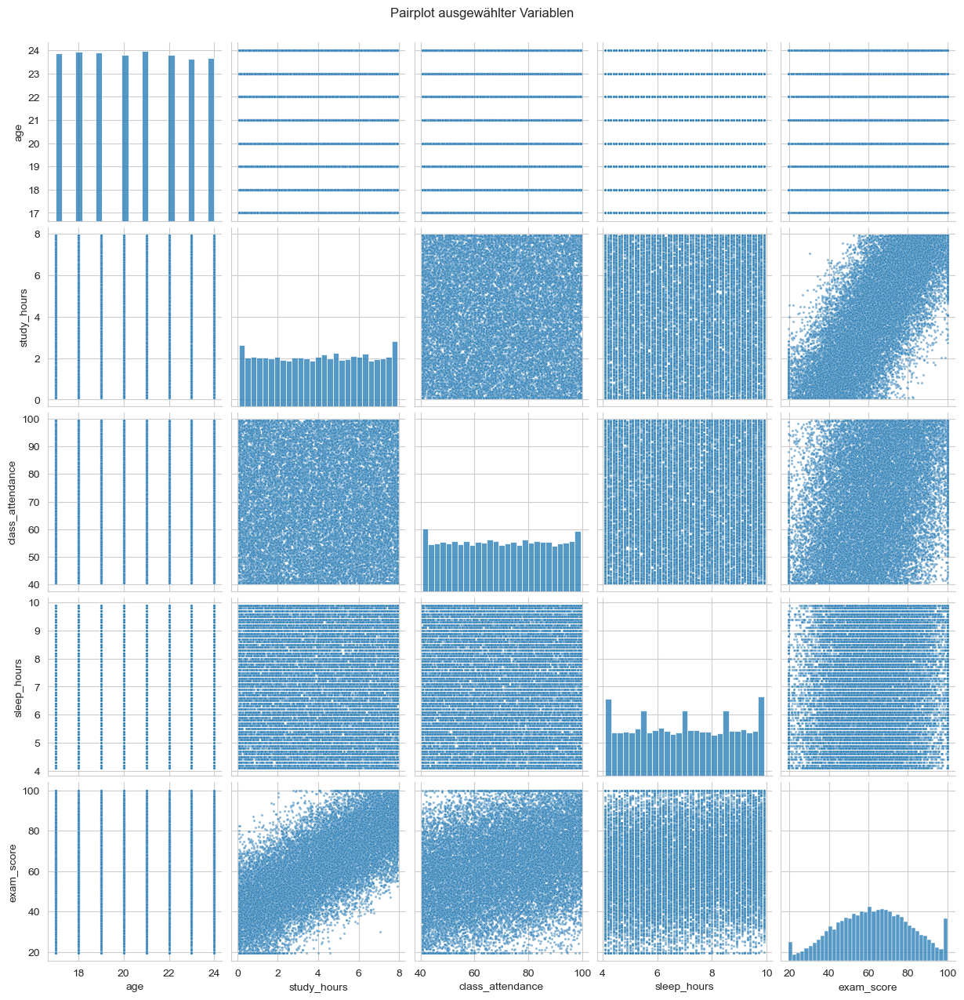

In [22]:
# Optional: Pairplot für ausgewählte Variablen
# selected_cols = ['spalte1', 'spalte2', 'spalte3', 'spalte4']
# sns.pairplot(df[selected_cols])
# plt.suptitle('Pairplot ausgewählter Variablen', y=1.02)
# plt.show()

# Pairplot für numeric_columns
selected_cols = numeric_cols
sns.pairplot(df[selected_cols], plot_kws={'s': 5, 'alpha': 0.5})
plt.suptitle('Pairplot ausgewählter Variablen', y=1.02)
plt.show()

---
## 6. Multivariate Analysen

**Aufgabe:** Visualisieren Sie Beziehungen zwischen mehreren Variablen gleichzeitig.

**Mögliche Visualisierungen:**
- Scatter Plots mit Farb- oder Größenkodierung
- Facet Grids (mehrere Subplots)
- Stacked Bar Charts
- Bubble Charts

In [23]:
# Beispiel: Scatter Plot mit Farbkodierung
# plt.figure(figsize=(12, 6))
# for category in df['kategoriale_spalte'].unique():
#     subset = df[df['kategoriale_spalte'] == category]
#     plt.scatter(subset['spalte1'], subset['spalte2'], label=category, alpha=0.6)
# plt.title('Beziehung mit Kategorisierung')
# plt.xlabel('[Spalte1]')
# plt.ylabel('[Spalte2]')
# plt.legend()
# plt.show()


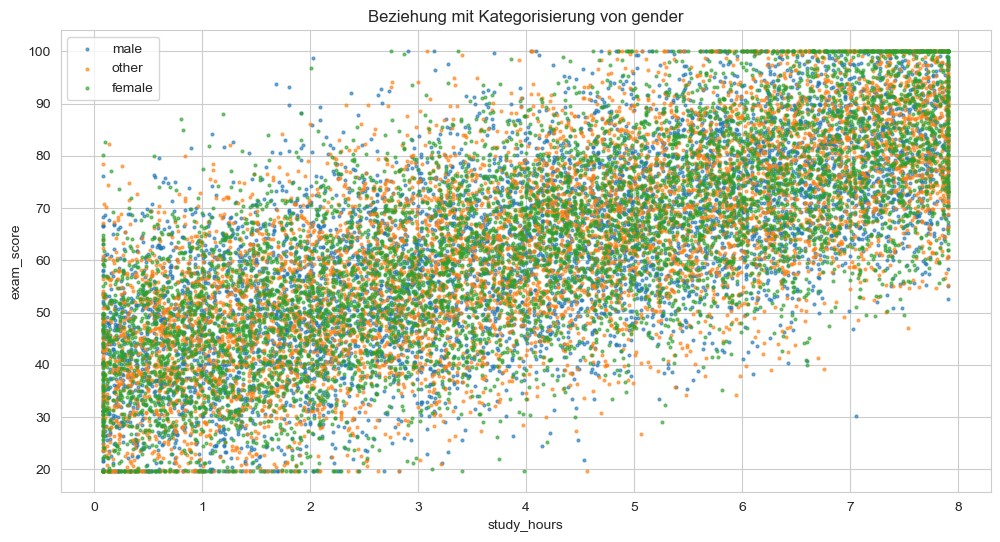

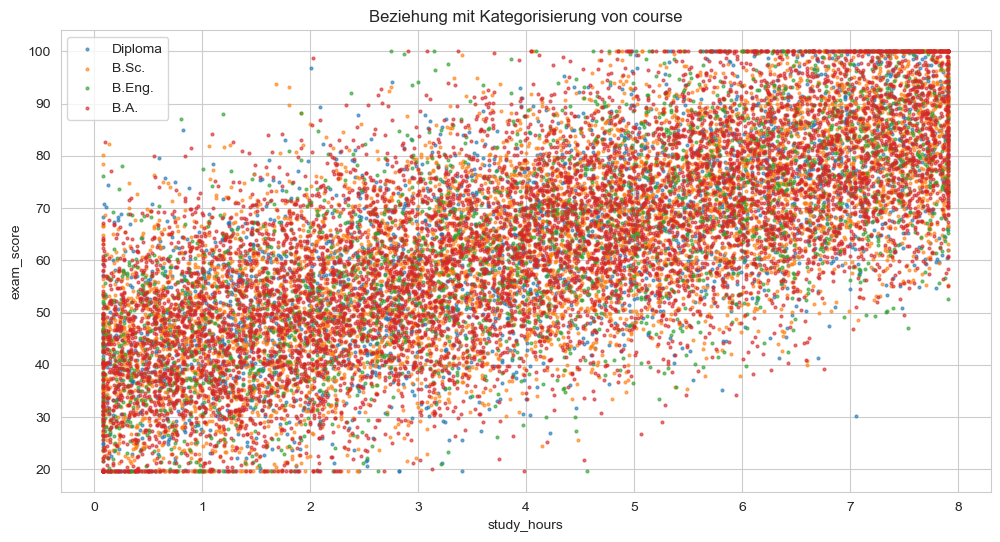

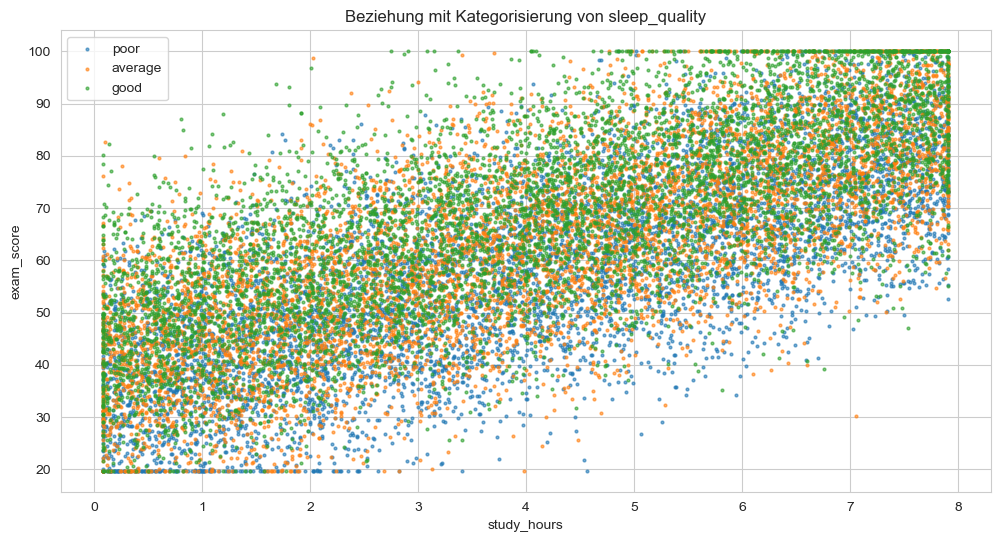

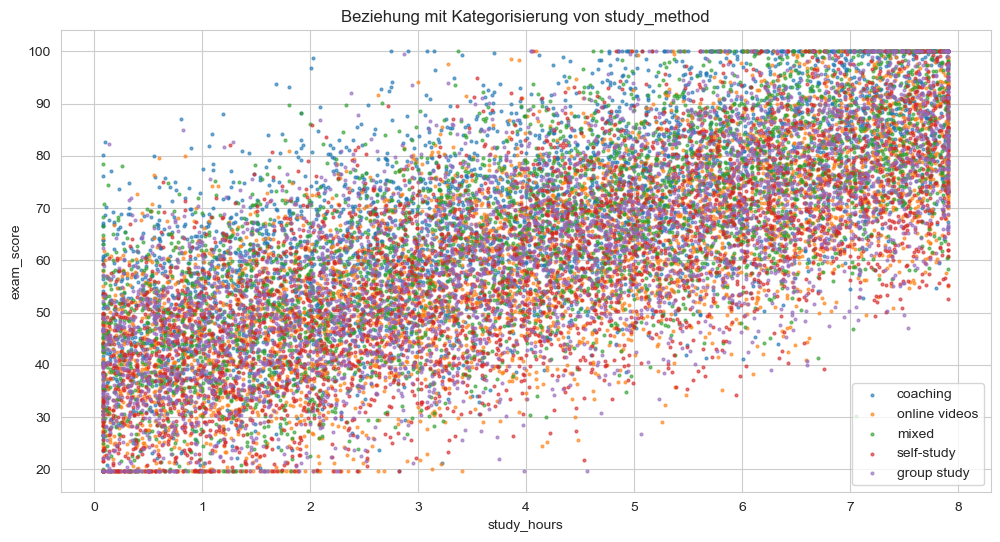

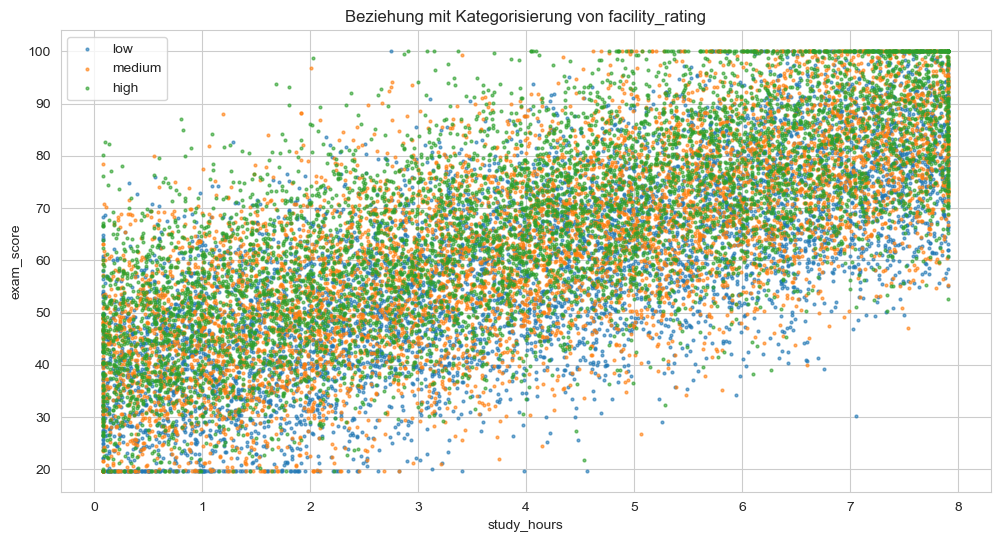

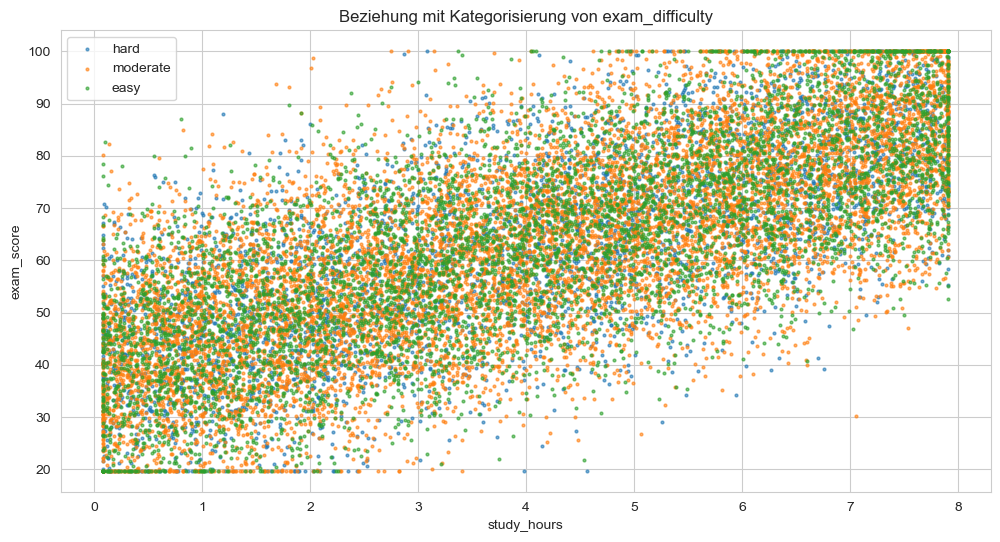

In [24]:
# Scatter Plot mit Farbkodierung
# - gender: study_hours vs. exam_score
# - course: study_hours vs. exam_score
# - internet_access: study_hours vs. exam_score
# - sleep_quality: study_hours vs. exam_score
# - study_method: study_hours vs. exam_score
# - (facility_rating: study_hours vs. exam_score)
# - exam_difficulty: study_hours vs. exam_score

for cat_col in categorical_cols:
    plt.figure(figsize=(12, 6))
    for category in df[cat_col].unique():
        subset = df[df[cat_col] == category]
        plt.scatter(subset['study_hours'], subset['exam_score'], label=category, alpha=0.6, s=4)
    plt.title(f'Beziehung mit Kategorisierung von {cat_col}')
    plt.xlabel('study_hours')
    plt.ylabel('exam_score')
    plt.legend()
    plt.show()


In [25]:
# Beispiel: Seaborn FacetGrid
# g = sns.FacetGrid(df, col='kategoriale_spalte', height=4, aspect=1.5)
# g.map(plt.hist, 'numerische_spalte', bins=20)
# g.set_axis_labels('[Numerische Spalte]', 'Häufigkeit')
# g.set_titles(col_template='{col_name}')
# plt.show()


exam score distribution for gender


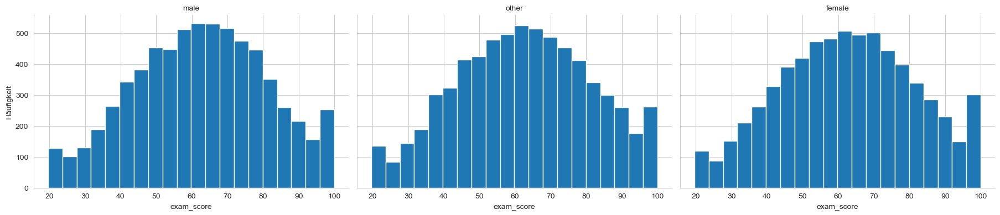

exam score distribution for course


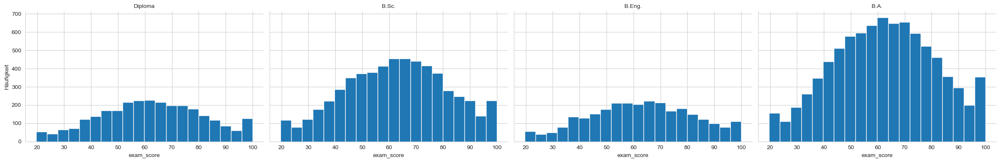

exam score distribution for sleep_quality


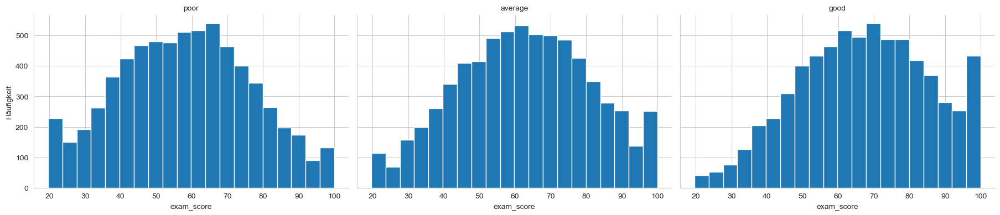

exam score distribution for study_method


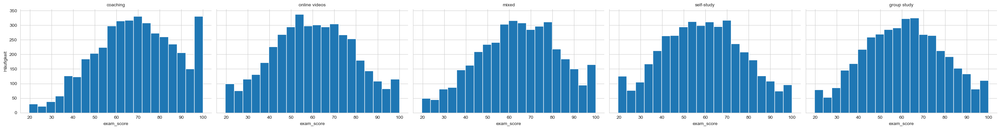

exam score distribution for facility_rating


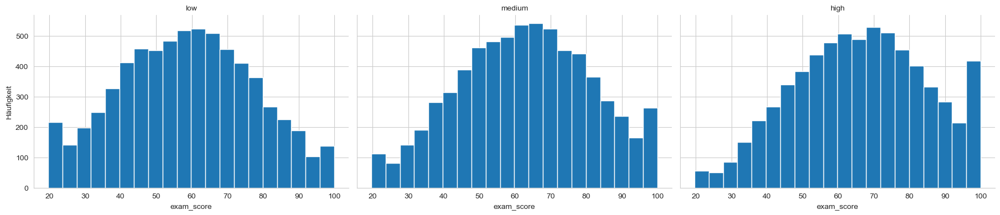

exam score distribution for exam_difficulty


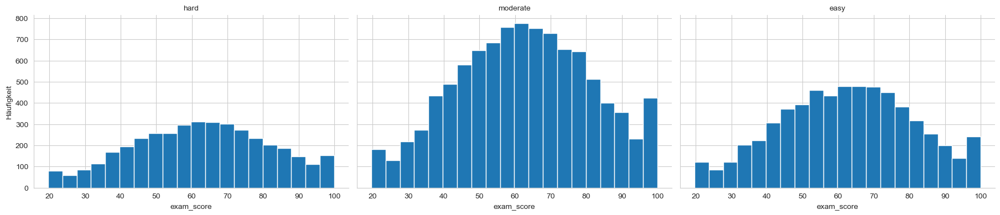

In [26]:
# Seaborn FacetGrid
for cat_col in categorical_cols:
    g = sns.FacetGrid(df, col=cat_col, height=4, aspect=1.5)
    g.map(plt.hist, 'exam_score', bins=20)
    g.set_axis_labels('exam_score', 'Häufigkeit')
    g.set_titles(col_template='{col_name}')
    print(f'exam score distribution for {cat_col}')
    plt.show()


---
## 7. Interaktive Visualisierungen mit Plotly (Bonus!)

**Aufgabe:** Erstellen Sie interaktive Visualisierungen mit Plotly.

**Vorteile von interaktiven Plots:**
- Zoom- und Pan-Funktionen
- Hover-Informationen
- Dynamische Filter
- Bessere Exploration komplexer Daten

**Hinweis:** Diese Plots sind besonders nützlich für Ihre Streamlit-App!

In [27]:
# Beispiel: Interaktiver Scatter Plot
# fig = px.scatter(df,
#                  x='spalte1',
#                  y='spalte2',
#                  color='kategoriale_spalte',
#                  size='spalte3',  # optional: Größe nach dritter Variable
#                  hover_data=['spalte4', 'spalte5'],  # zusätzliche Infos beim Hovern
#                  title='Interaktiver Scatter Plot')
# fig.show()

fig = px.scatter(
    df,
    x="study_hours",
    y="exam_score",
    color="sleep_quality",
    hover_data=[
        "age",
        "gender",
        "course",
        "class_attendance",
        "internet_access",
        "sleep_hours",
        "study_method",
        "facility_rating",
        "exam_difficulty",
    ],
    title="Interaktiver Scatter Plot",
)
fig.update_traces(
    marker=dict(
        size=5,
        opacity=0.7,
    )
)
fig.show()

In [28]:
# Beispiel: Interaktives Histogramm
# fig = px.histogram(df, 
#                    x='numerische_spalte',
#                    color='kategoriale_spalte',
#                    marginal='box',  # Boxplot am Rand
#                    title='Interaktives Histogramm')
# fig.show()

fig = px.histogram(df, 
                   x='exam_score',
                   color='study_method',
                   marginal='box',  # Boxplot am Rand
                   title='Interaktives Histogramm')
fig.show()


In [29]:
# Beispiel: Interaktiver Box Plot
# fig = px.box(df, 
#              x='kategoriale_spalte', 
#              y='numerische_spalte',
#              color='kategoriale_spalte',
#              title='Interaktiver Box Plot')
# fig.show()

fig = px.box(df, 
             x='study_method', 
             y='exam_score',
             color='sleep_quality',
             title='Interaktiver Box Plot')
fig.show()


In [30]:
# Optional: Interaktive Korrelationsmatrix
# fig = px.imshow(correlation_matrix,
#                 text_auto=True,
#                 color_continuous_scale='RdBu_r',
#                 title='Interaktive Korrelationsmatrix')
# fig.show()

fig = px.imshow(
    correlation_matrix,
    text_auto=True,
    color_continuous_scale="RdBu_r",
    title="Interaktive Korrelationsmatrix",
    width=800,
    height=800,
)
fig.show()

---
## 8. Visualisierungen für Ihre Forschungsfrage

**Aufgabe:** Nachdem Sie in den Aufgaben 1-7 "experimentiert" haben, erstellen Sie jetzt spezifische Visualisierungen, die Ihre Forschungsfrage beantworten.

**Überlegen Sie:**
- Welche Variablen sind für Ihre Forschungsfrage am wichtigsten?
- Welche Visualisierungen zeigen die relevanten Muster am besten?
- Welche Insights können Sie aus den Daten gewinnen?

**Erstellen Sie mindestens 3 aussagekräftige Visualisierungen!**

**Research Question:**
"Can we predict exam scores based on a student’s academic behavior, study habits, lifestyle routines, and exam conditions?"

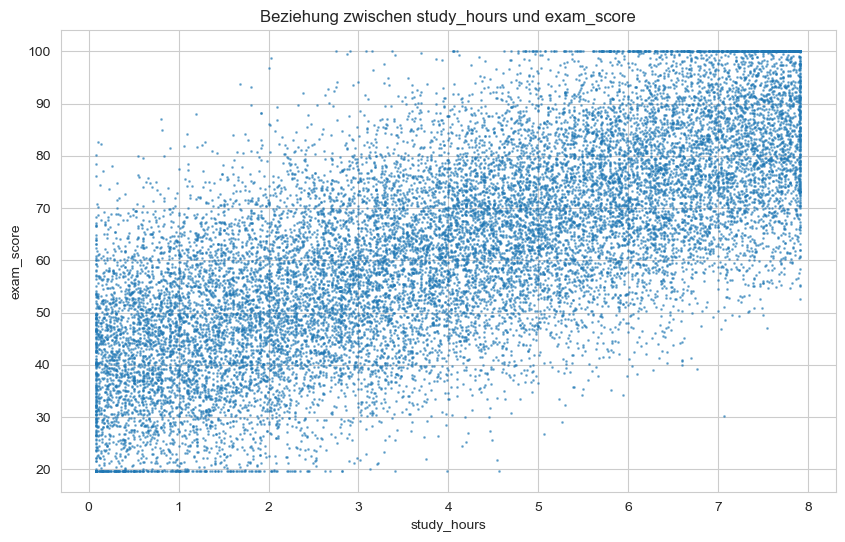

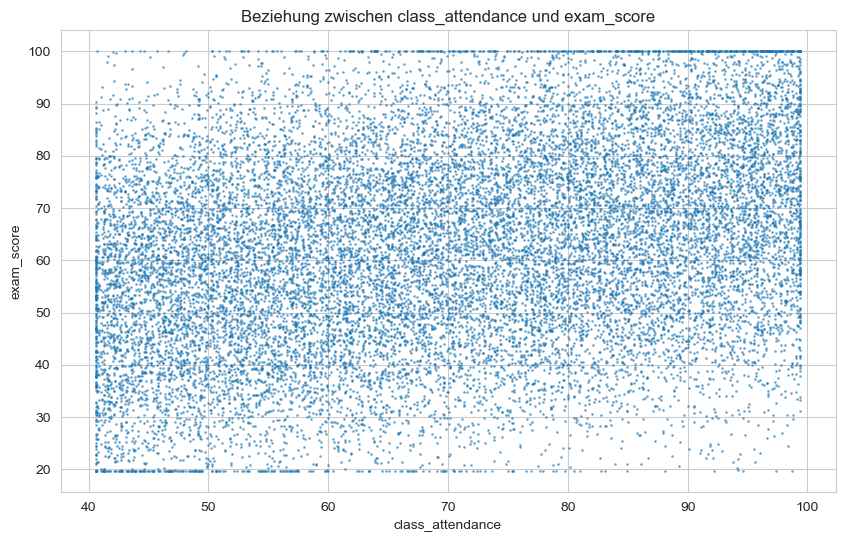

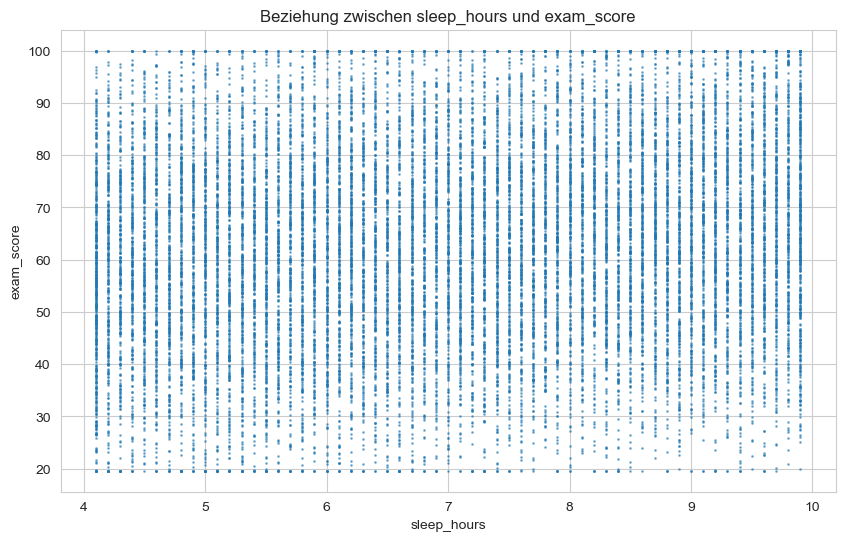

In [31]:
# Visualisierung X: [Beschreibung]
# Scatter Plot (num_col vs. exam_score)
# numeric_cols besteht aus ['age', 'study_hours', 'class_attendance', 'sleep_hours', 'exam_score']
for num_col in numeric_cols[1:4]:
    plt.figure(figsize=(10, 6))
    plt.scatter(df[num_col], df['exam_score'], alpha=0.5, s=1)
    plt.title(f'Beziehung zwischen {num_col} und exam_score')
    plt.xlabel(num_col)
    plt.ylabel('exam_score')
    plt.show()


- study_hours hat großen Einfluss auf exam_score
- class_attendance auch, aber weniger
- sleep_hours hat kaum Einfluss, da bei allen angegebenen sleep_hours eine ähnliche exam_score-Verteilung ist.

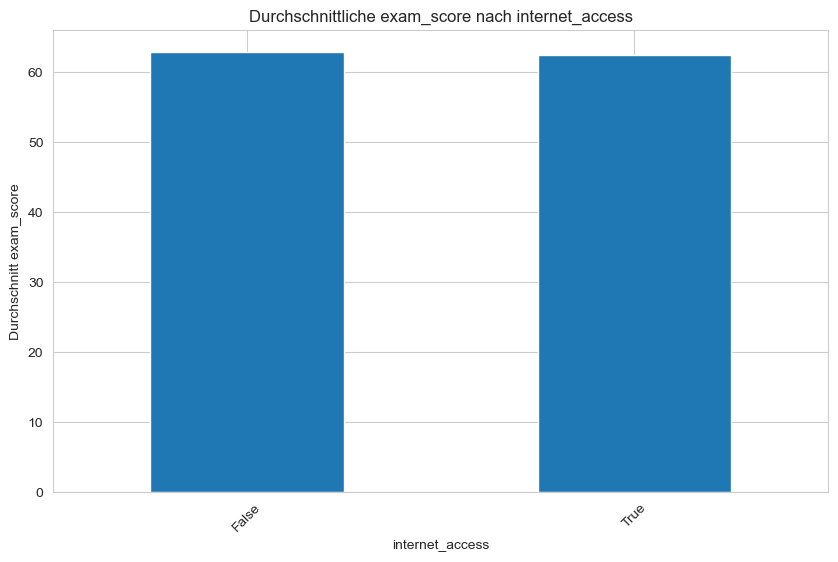

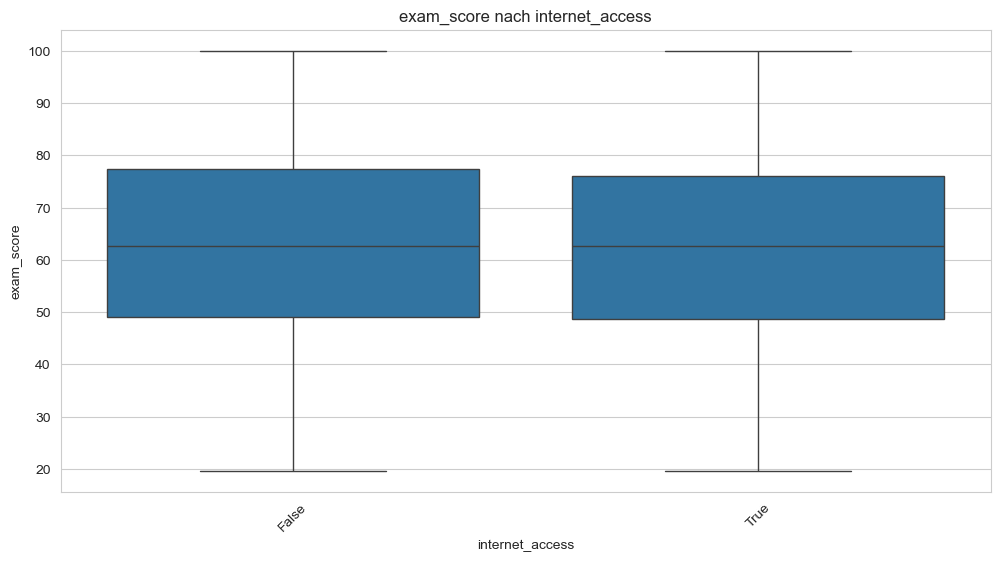

In [32]:
# Grouped Bar Chart (internet_access vs. exam_score)
grouped_data = df.groupby('internet_access')['exam_score'].mean()
plt.figure(figsize=(10, 6))
grouped_data.plot(kind='bar')
plt.title('Durchschnittliche exam_score nach internet_access')
plt.xlabel('internet_access')
plt.ylabel('Durchschnitt exam_score')
plt.xticks(rotation=45)
plt.show()

# Boxplot nach Kategorien (internet_access vs. exam_score)
plt.figure(figsize=(12, 6))
sns.boxplot(data=df, x='internet_access', y='exam_score')
plt.title('exam_score nach internet_access')
plt.xticks(rotation=45)
plt.show()


- internet_access hat kaum Einfluss, da exam_scores bei Studenten mit oder ohne Internetzugang sehr ähnlich sind.

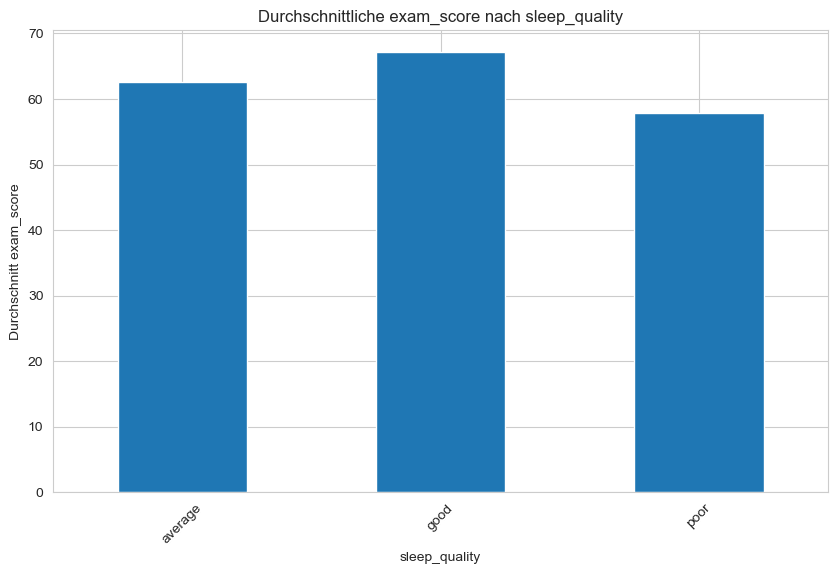

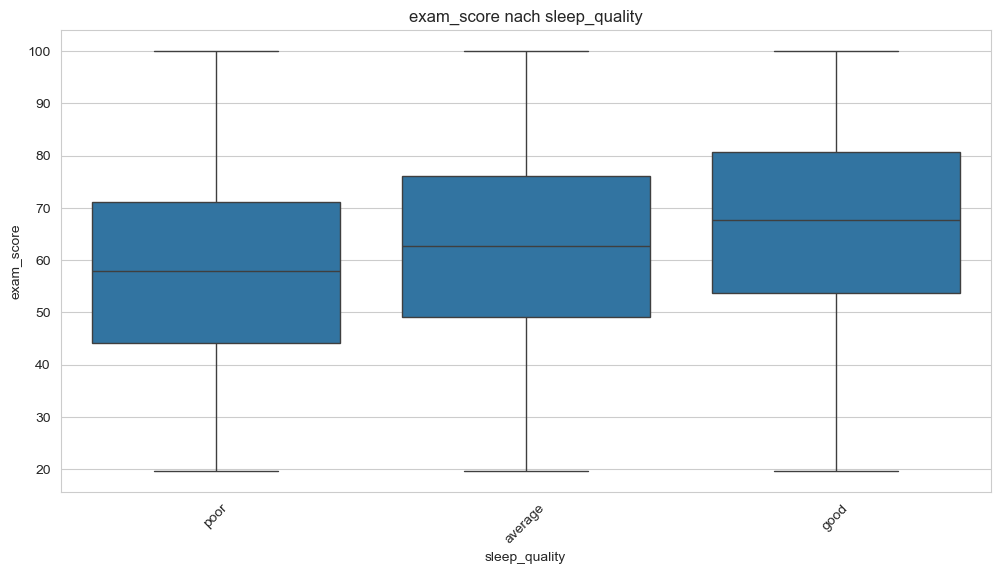

In [33]:
# Visualisierung X: [Beschreibung]
# Grouped Bar Chart (sleep_quality vs. exam_score)
grouped_data = df.groupby('sleep_quality')['exam_score'].mean()
plt.figure(figsize=(10, 6))
grouped_data.plot(kind='bar')
plt.title('Durchschnittliche exam_score nach sleep_quality')
plt.xlabel('sleep_quality')
plt.ylabel('Durchschnitt exam_score')
plt.xticks(rotation=45)
plt.show()

# Boxplot nach Kategorien (sleep_quality vs. exam_score)
plt.figure(figsize=(12, 6))
sns.boxplot(data=df, x='sleep_quality', y='exam_score')
plt.title('exam_score nach sleep_quality')
plt.xticks(rotation=45)
plt.show()



- sleep_quality hat auch etwas Einfluss auf die exam_score. Boxplot zeigt, dass die durchschnittlichen exam_scores besser sind, je besser die sleep_quality ist.

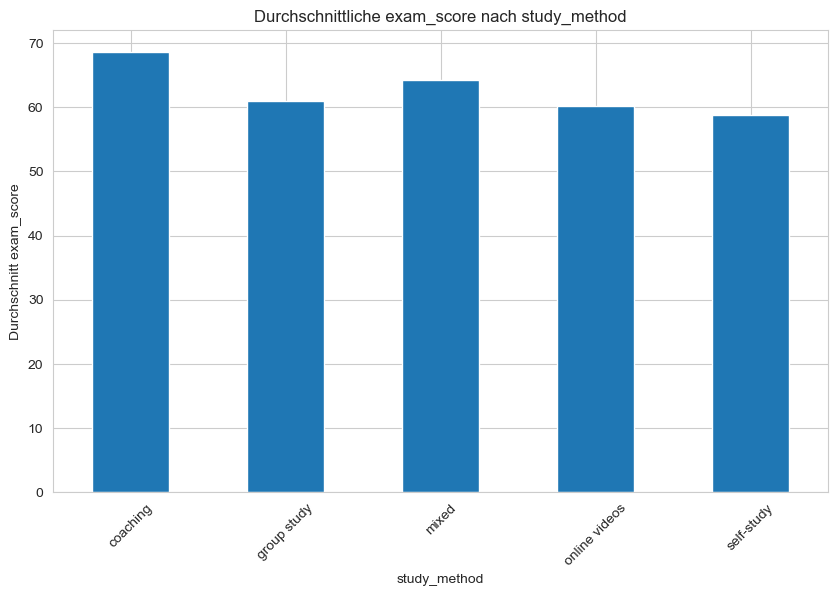

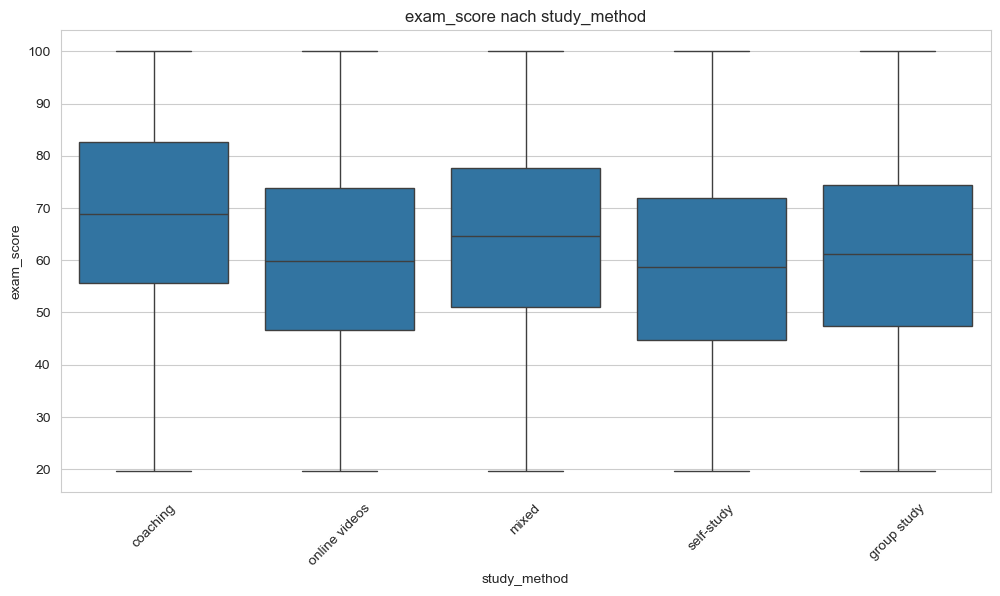

In [34]:
# Grouped Bar Chart (study_method vs. exam_score)
grouped_data = df.groupby('study_method')['exam_score'].mean()
plt.figure(figsize=(10, 6))
grouped_data.plot(kind='bar')
plt.title('Durchschnittliche exam_score nach study_method')
plt.xlabel('study_method')
plt.ylabel('Durchschnitt exam_score')
plt.xticks(rotation=45)
plt.show()

# Boxplot nach Kategorien (study_method vs. exam_score)
plt.figure(figsize=(12, 6))
sns.boxplot(data=df, x='study_method', y='exam_score')
plt.title('exam_score nach study_method')
plt.xticks(rotation=45)
plt.show()


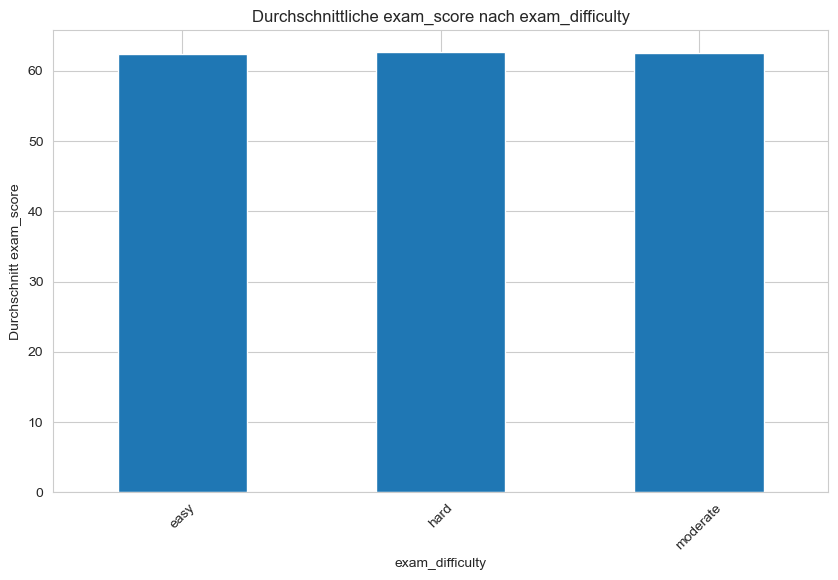

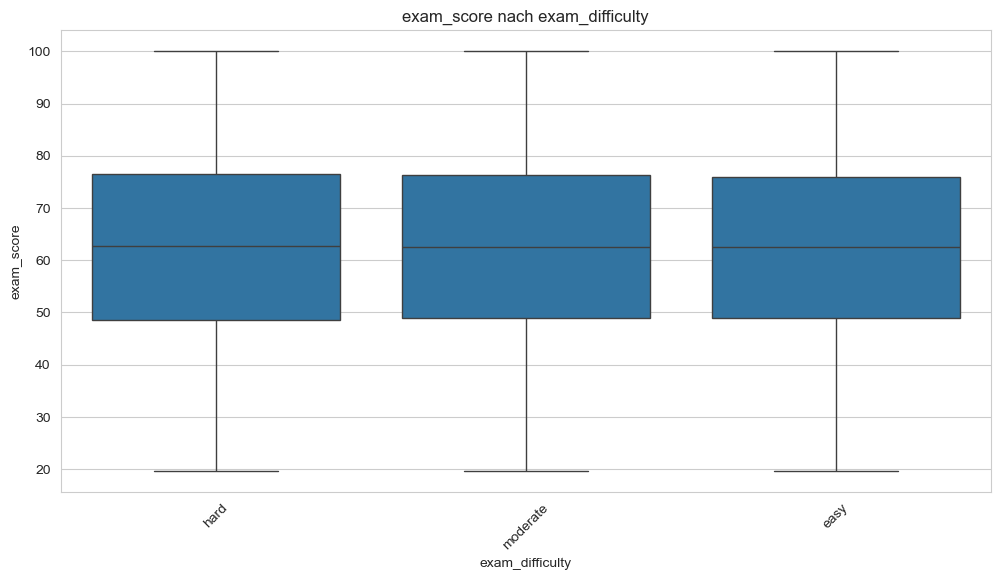

In [35]:
# Grouped Bar Chart (exam_difficulty vs. exam_score)
grouped_data = df.groupby('exam_difficulty')['exam_score'].mean()
plt.figure(figsize=(10, 6))
grouped_data.plot(kind='bar')
plt.title('Durchschnittliche exam_score nach exam_difficulty')
plt.xlabel('exam_difficulty')
plt.ylabel('Durchschnitt exam_score')
plt.xticks(rotation=45)
plt.show()

# Boxplot nach Kategorien (exam_difficulty vs. exam_score)
plt.figure(figsize=(12, 6))
sns.boxplot(data=df, x='exam_difficulty', y='exam_score')
plt.title('exam_score nach exam_difficulty')
plt.xticks(rotation=45)
plt.show()


- die Diagramme zeigen, dass die exam_difficulty anders als erwartet keinen wesentlichen Einfluss auf die exam_score haben. Egal ob die exam easy, moderate oder hard war, stimmt der durchschnittliche exam_score fast miteinander überein.

**Interpretation Visualisierung 2:**
- ...

In [36]:
# Visualisierung 3: [Beschreibung]



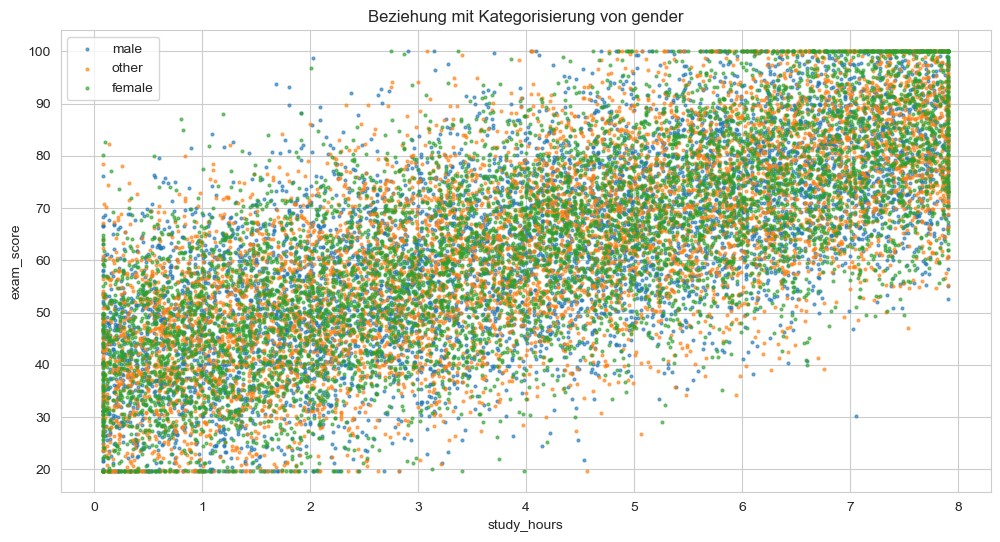

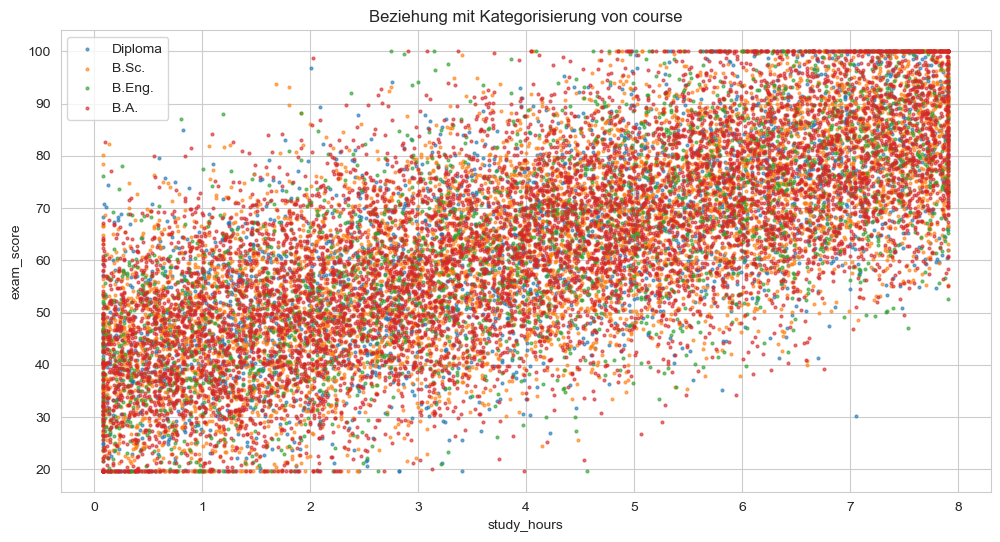

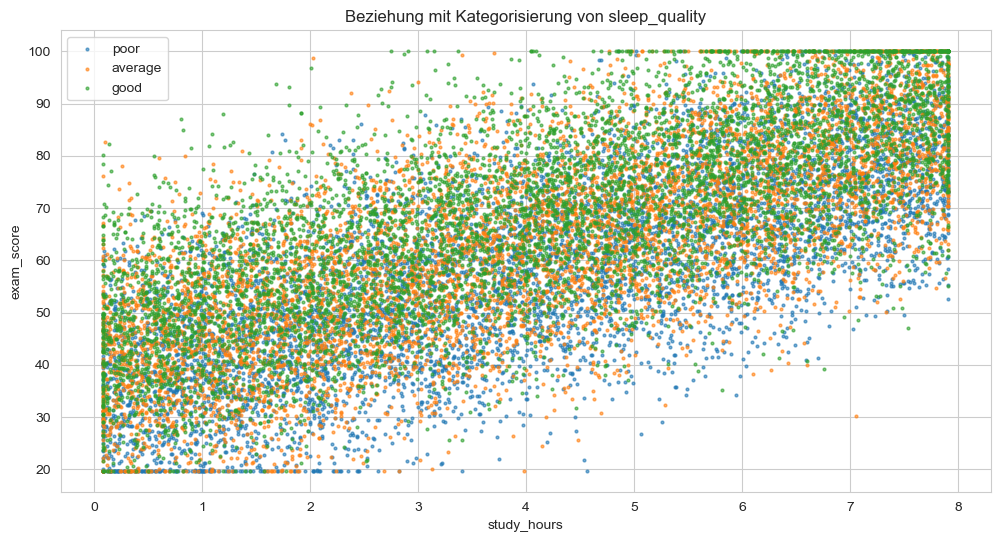

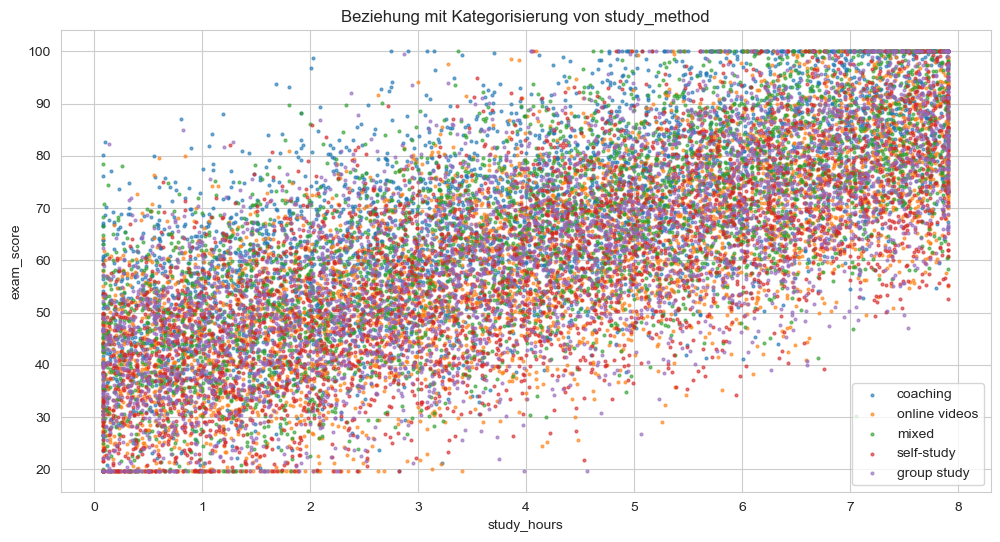

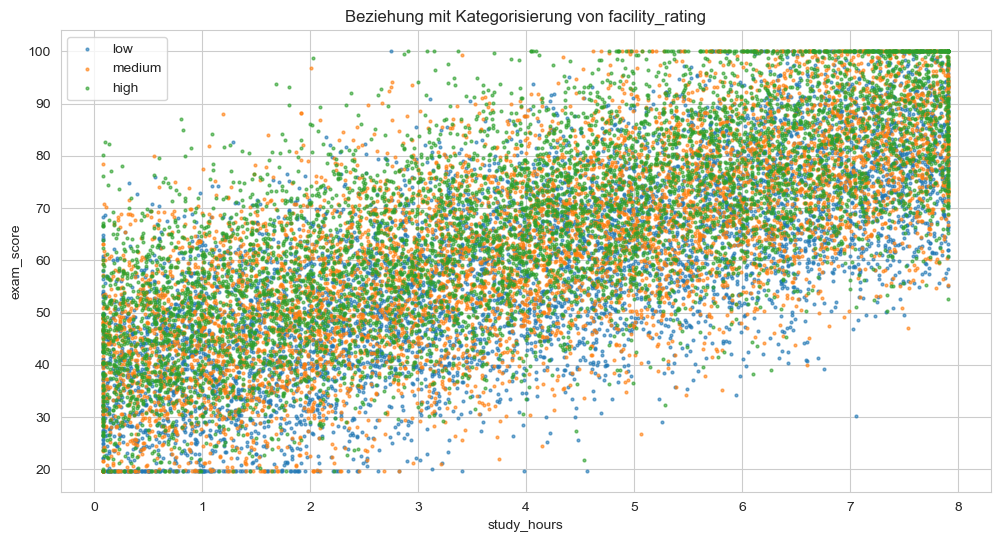

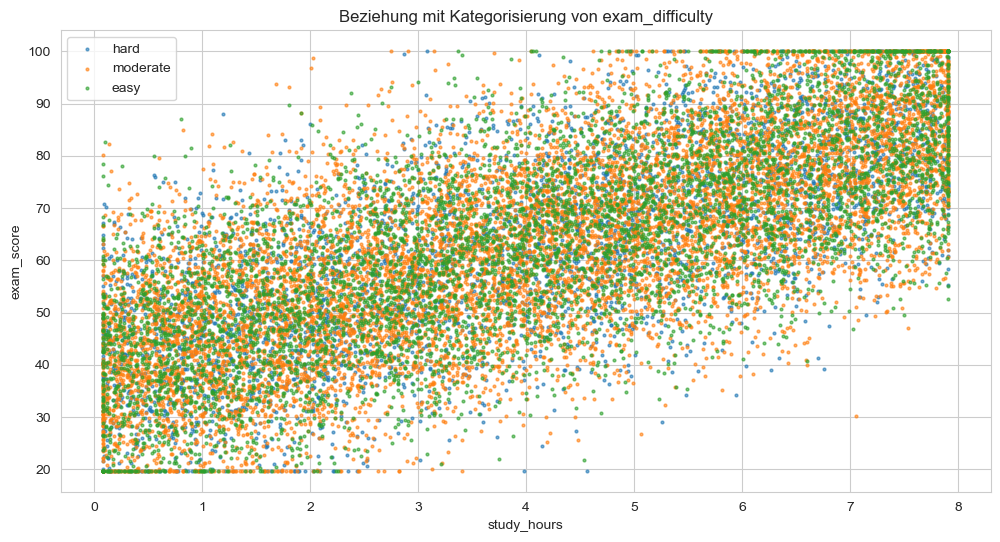

In [37]:
# Scatter Plot mit Farbkodierung: categorical_cols
# - gender: study_hours vs. exam_score
# - course: study_hours vs. exam_score
# - internet_access: study_hours vs. exam_score
# - sleep_quality: study_hours vs. exam_score
# - study_method: study_hours vs. exam_score
# - (facility_rating: study_hours vs. exam_score)
# - exam_difficulty: study_hours vs. exam_score

for cat_col in categorical_cols:
    plt.figure(figsize=(12, 6))
    for category in df[cat_col].unique():
        subset = df[df[cat_col] == category]
        plt.scatter(subset['study_hours'], subset['exam_score'], label=category, alpha=0.6, s=4)
    plt.title(f'Beziehung mit Kategorisierung von {cat_col}')
    plt.xlabel('study_hours')
    plt.ylabel('exam_score')
    plt.legend()
    plt.show()


- gender, course und exam_difficulty haben keinen direkten Einfluss auf die exam_score
- je besser die sleep_quality, desto besser die exam_score
- mit den study_methods "coaching" und "mixed" werden die besten exam_scores erreicht
- je besser das facility_rating, desto besser die exam_score


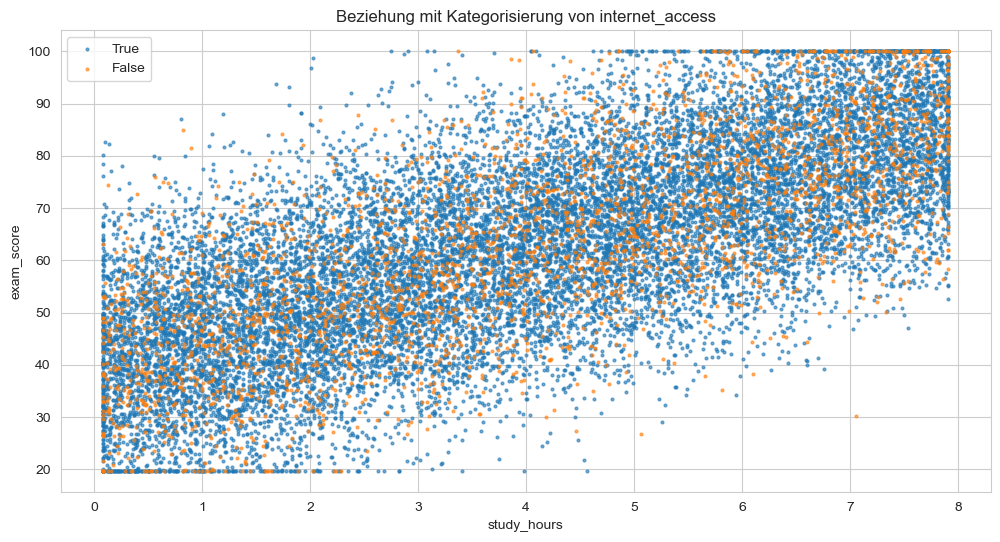

In [38]:
# Scatter Plot mit Farbkodierung: internet_access, da dtype == bool
# - internet_access: study_hours vs. exam_score
plt.figure(figsize=(12, 6))
for category in df['internet_access'].unique():
    subset = df[df['internet_access'] == category]
    plt.scatter(subset['study_hours'], subset['exam_score'], label=category, alpha=0.6, s=4)
plt.title('Beziehung mit Kategorisierung von internet_access')
plt.xlabel('study_hours')
plt.ylabel('exam_score')
plt.legend()
plt.show()

exam score distribution for gender


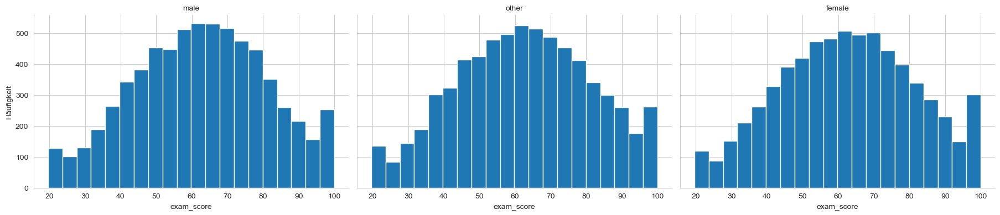

exam score distribution for course


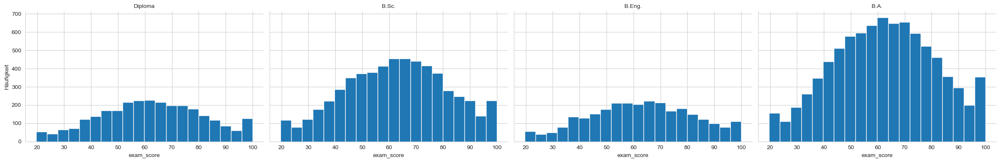

exam score distribution for sleep_quality


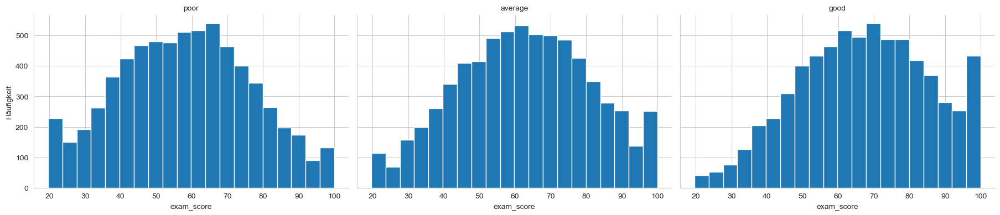

exam score distribution for study_method


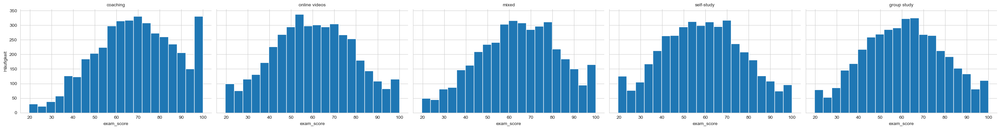

exam score distribution for facility_rating


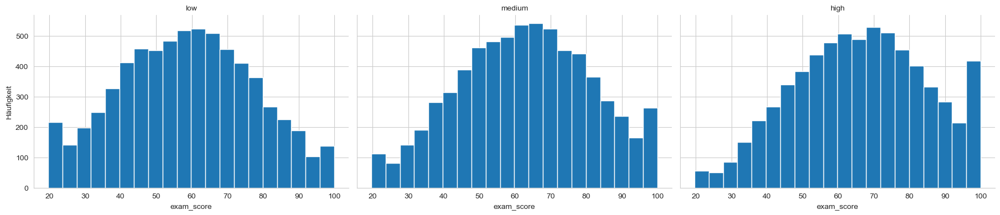

exam score distribution for exam_difficulty


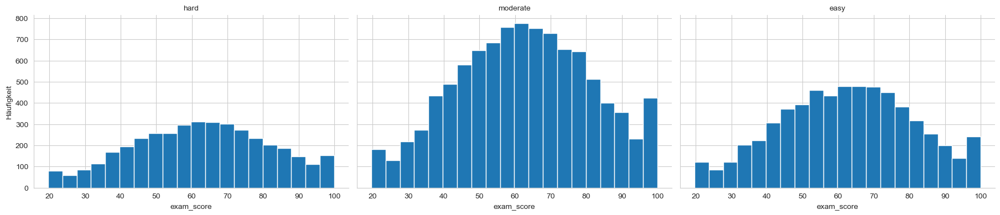

In [39]:
# alternativ:
# Seaborn FacetGrid
for cat_col in categorical_cols:
    g = sns.FacetGrid(df, col=cat_col, height=4, aspect=1.5)
    g.map(plt.hist, 'exam_score', bins=20)
    g.set_axis_labels('exam_score', 'Häufigkeit')
    g.set_titles(col_template='{col_name}')
    print(f'exam score distribution for {cat_col}')
    plt.show()


In [40]:
# Interaktiver Scatter Plot:
fig = px.scatter(
    df,
    x="study_hours",
    y="exam_score",
    color="sleep_quality",
    hover_data=[
        "age",
        "gender",
        "course",
        "class_attendance",
        "internet_access",
        "sleep_hours",
        "study_method",
        "facility_rating",
        "exam_difficulty",
    ],
    title="Interaktiver Scatter Plot",
)
fig.update_traces(
    marker=dict(
        size=5,
        opacity=0.7,
    )
)
fig.show()

In [41]:
# Interaktives Histogramm
fig = px.histogram(df, 
                   x='exam_score',
                   color='study_method',
                   marginal='box',  # Boxplot am Rand
                   title='Interaktives Histogramm')
fig.show()


In [42]:
# Interaktiver Box Plot
fig = px.box(df, 
             x='study_method', 
             y='exam_score',
             color='sleep_quality',
             title='Interaktiver Box Plot')
fig.show()


In [43]:
# Interaktive Korrelationsmatrix
fig = px.imshow(
    correlation_matrix,
    text_auto=True,
    color_continuous_scale="RdBu_r",
    title="Interaktive Korrelationsmatrix",
    width=800,
    height=800,
)
fig.show()

**Interpretation Visualisierung 3:**
- ...

In [44]:
# Weitere Visualisierungen nach Bedarf



---
## 9. Visualisierungen speichern

**Aufgabe:** Speichern Sie Ihre wichtigsten Visualisierungen als Bilddateien.

**Hinweise:**
- Speichern Sie Plots in hoher Qualität (dpi=300)
- Verwenden Sie aussagekräftige Dateinamen
- Diese Bilder können Sie in Präsentationen oder Berichten verwenden
- Für Streamlit: Visualisierungen werden direkt im Code erstellt, nicht als Bilder eingebunden

In [45]:
# Beispiel: Matplotlib/Seaborn Plot speichern
# plt.figure(figsize=(10, 6))
# # ... Ihr Plot-Code ...
# plt.savefig('plot_name.png', dpi=300, bbox_inches='tight')
# plt.show()


In [46]:
# Beispiel: Plotly Plot als HTML speichern (für interaktive Nutzung)
# fig = px.scatter(...)  # Ihr Plotly Plot
# fig.write_html('interactive_plot.html')


---
## 10. Qualitätskontrolle durch Visualisierung

**Aufgabe:** Nutzen Sie Visualisierungen zur Qualitätskontrolle Ihrer Daten.

**Prüfen Sie:**
- Sind alle Ausreißer sinnvoll?
- Gibt es unerwartete Muster?
- Sind kategoriale Variablen konsistent kodiert?
- Gibt es offensichtliche Datenfehler?

**Falls Sie Probleme entdecken:** Gehen Sie zurück zu Ihrem Data Cleaning Notebook und korrigieren Sie diese!

In [47]:
# Qualitätskontrolle: Überprüfen Sie Ihre Daten visuell



**Beobachtungen aus der Qualitätskontrolle:**
- ...

---
## Reflexion

**Dokumentieren Sie Ihre Arbeit:**

Beantworten Sie folgende Fragen:

1. Welche Visualisierungen waren am aufschlussreichsten für Ihre Forschungsfrage?
2. Welche unerwarteten Muster oder Erkenntnisse haben Sie entdeckt?
3. Welche Visualisierungstypen eignen sich am besten für Ihren Datensatz?
4. Welche Visualisierungen planen Sie für Ihre Streamlit-App zu verwenden?
5. Gab es Herausforderungen bei der Visualisierung? Wie haben Sie diese gelöst?
6. Haben die Visualisierungen neue Fragen aufgeworfen oder Ideen für weitere Analysen gegeben?

### Ihre Reflexion:

1. **Aufschlussreichste Visualisierungen:**
   - ...

2. **Unerwartete Erkenntnisse:**
   - ...

3. **Geeignetste Visualisierungstypen:**
   - ...

4. **Geplante Visualisierungen für Streamlit:**
   - ...

5. **Herausforderungen und Lösungen:**
   - ...

6. **Neue Fragen und Ideen:**
   - ...

---
## Zusammenfassung und nächste Schritte

**Sie haben in dieser Übung:**
- ✅ Verschiedene Visualisierungstypen auf Ihre Daten angewendet
- ✅ Univariate, bivariate und multivariate Analysen durchgeführt
- ✅ Interaktive Visualisierungen mit Plotly erstellt
- ✅ Spezifische Visualisierungen für Ihre Forschungsfrage entwickelt
- ✅ Ihre Datenqualität visuell überprüft

**Nächste Woche (Woche 9):**
- Machine Learning Grundlagen
- Erste ML-Modelle auf Ihren Daten trainieren
- Modell-Evaluation

**Tipp:** Speichern Sie dieses Notebook gut ab - die Visualisierungen bilden die Grundlage für Ihre Streamlit-App in Woche 10 und 11!